In [1]:
#!pip install jupyternotify
#!pip install pandas-profiling
#!pip install mlxtend
#!pip install cpi
#!pip install ydata-profiling

In [2]:
#%notify
%load_ext jupyternotify
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import json
import cpi
import re
import math
import ast
from collections import Counter
from ydata_profiling import ProfileReport

<IPython.core.display.Javascript object>

In [3]:
cpi.update()

In [4]:
# calling the csv created in the first notebook with movie info 
tmdb_df_csv = pd.read_csv("path of the csv that contains movie info API results")

# First pre-processing steps

In [5]:
# list of columns
tmdb_df_csv.columns

Index(['Unnamed: 0.42', 'Unnamed: 0.41', 'Unnamed: 0.40', 'Unnamed: 0.39',
       'Unnamed: 0.38', 'Unnamed: 0.37', 'Unnamed: 0.36', 'Unnamed: 0.35',
       'Unnamed: 0.34', 'Unnamed: 0.33', 'Unnamed: 0.32', 'Unnamed: 0.31',
       'Unnamed: 0.30', 'Unnamed: 0.29', 'Unnamed: 0.28', 'Unnamed: 0.27',
       'Unnamed: 0.26', 'Unnamed: 0.25', 'Unnamed: 0.24', 'Unnamed: 0.23',
       'Unnamed: 0.22', 'Unnamed: 0.21', 'Unnamed: 0.20', 'Unnamed: 0.19',
       'Unnamed: 0.18', 'Unnamed: 0.17', 'Unnamed: 0.16', 'Unnamed: 0.15',
       'Unnamed: 0.14', 'Unnamed: 0.13', 'Unnamed: 0.12', 'Unnamed: 0.11',
       'Unnamed: 0.10', 'Unnamed: 0.9', 'Unnamed: 0.8', 'Unnamed: 0.7',
       'Unnamed: 0.6', 'Unnamed: 0.5', 'Unnamed: 0.4', 'Unnamed: 0.3',
       'Unnamed: 0.2', 'Unnamed: 0.1', 'id', 'title', 'adult',
       'belongs_to_collection', 'release_date', 'budget', 'genres', 'imdb_id',
       'language', 'overview', 'production_companies', 'country', 'runtime',
       'status', 'vote_count', 'rating

In [6]:
# dropping all columns starting by unnamed
tmdb_df_1 = tmdb_df_csv.drop([col for col in tmdb_df_csv.columns if col.startswith("Unnamed")], axis=1)
tmdb_df_1 = tmdb_df_1.drop('imdb_id', axis=1)

In [7]:
tmdb_df_1.columns

Index(['id', 'title', 'adult', 'belongs_to_collection', 'release_date',
       'budget', 'genres', 'language', 'overview', 'production_companies',
       'country', 'runtime', 'status', 'vote_count', 'rating'],
      dtype='object')

In [8]:
# info
pd.options.display.float_format = '{:,.2f}'.format
tmdb_df_1.describe().T

,count,mean,std,min,25%,50%,75%,max
id,807259.0,566418.959556,3.073793e+05,2.0,323328.5,561641.0,816524.0,1127091.0
budget,807259.0,342549.191110,5.133366e+06,0.0,0.0,0.0,0.0,460000000.0
runtime,807259.0,111.540677,5.586035e+04,0.0,2.0,32.0,90.0,50189181.0
vote_count,807259.0,25.369243,3.662576e+02,0.0,0.0,0.0,2.0,33838.0
rating,807259.0,2.356447,3.163627e+00,0.0,0.0,0.0,5.5,10.0


In [9]:
tmdb_df_1.shape

(807259, 15)

In [10]:
# dropping duplicate
tmdb_df_2 = tmdb_df_1.drop_duplicates()

In [11]:
tmdb_df_2.shape

(794600, 15)

### Removing anomalies 

In [12]:
pd.options.display.float_format = '{:.2%}'.format
tmdb_df_2['status'].value_counts(normalize=True)

Released          98.80%
Planned            0.44%
In Production      0.36%
Post Production    0.35%
Canceled           0.03%
Rumored            0.02%
Name: status, dtype: float64

In [ ]:
pd.options.display.float_format = '{:,.2f}'.format

In [13]:
# only keeping released movies
tmdb_df_2_a = tmdb_df_2[tmdb_df_2['status']=="Released"]

In [14]:
tmdb_df_2_a.shape

(785071, 15)

In [15]:
# dropping pornographic movies
tmdb_df_3 = tmdb_df_2_a[tmdb_df_2_a['adult']==False]

In [16]:
tmdb_df_3.shape

(767986, 15)

In [17]:
# only considering movies with at least 50 votes
tmdb_df_4 = tmdb_df_3[tmdb_df_3['vote_count']>=50]

In [19]:
tmdb_df_4.shape

(26780, 15)

In [20]:
# only keeping feature films so more than 40 minutes
tmdb_df_5 = tmdb_df_4[tmdb_df_4['runtime']>40]

In [21]:
tmdb_df_5.shape

(25722, 15)

In [22]:
# only considering movies with an overview
tmdb_df_5 = tmdb_df_5[~tmdb_df_5['overview'].isna()]

In [23]:
tmdb_df_5.shape

(25665, 15)

In [24]:
# dropping columns adult and status because not useful anymore
tmdb_df_6 = tmdb_df_5.drop(['adult', 'status'], axis=1)

In [25]:
# release_date: split between month and year (dropping the day because not useful)
tmdb_df_6['release_date']= pd.to_datetime(tmdb_df_6['release_date'])
tmdb_df_6['month'] = tmdb_df_6['release_date'].dt.month
tmdb_df_6['year'] = tmdb_df_6['release_date'].dt.year

In [26]:
# drop the movies released in 2023 (rating not totally representative yet)
tmdb_df_6 = tmdb_df_6[tmdb_df_6['year'] != 2023]

In [27]:
tmdb_df_6.shape

(25501, 15)

In [28]:
numbers_df = pd.read_csv("path of the number csv", sep=';', encoding='cp1252')
numbers_df = numbers_df.drop('index', axis=1)

In [29]:
# creating special ID to merge df and avoiding duplicate (by adding the year)
numbers_df['id_budget'] = numbers_df['title']+numbers_df['year'].astype(str)
numbers_df = numbers_df.drop_duplicates()
tmdb_df_6['id_budget'] = tmdb_df_6['title']+tmdb_df_6['year'].astype(str)

In [30]:
# drop duplicates of id budget
tmdb_df_6 = tmdb_df_6.drop_duplicates(subset=['id_budget'], keep=False)

In [31]:
tmdb_df_6.shape

(25439, 16)

In [32]:
tmdb_df_6_b = pd.merge(tmdb_df_6, numbers_df, on='id_budget', how='left')

In [33]:
# still a duplicate
tmdb_6_dupli = tmdb_df_6_b[tmdb_df_6_b['id_budget'].duplicated()]
tmdb_6_dupli

,id,title_x,belongs_to_collection,release_date,budget_x,genres,language,overview,production_companies,country,runtime,vote_count,rating,month,year_x,id_budget,title_y,budget_y,year_y
7959,62320,Home,NaN,2009-06-03,0,"[{'id': 99, 'name': 'Documentary'}]",fr,"In 200,000 years of existence, man has upset t...","[{'id': 11359, 'logo_path': '/aqWJRi66t2oMPMmC...","[{'iso_3166_1': 'FR', 'name': 'France'}]",95,439,780.60%,6,2009,Home2009,Home,50000000.00%,200900.00%


In [34]:
tmdb_df_6_b[tmdb_df_6_b['id_budget']=='Home2009']

,id,title_x,belongs_to_collection,release_date,budget_x,genres,language,overview,production_companies,country,runtime,vote_count,rating,month,year_x,id_budget,title_y,budget_y,year_y
7958,62320,Home,NaN,2009-06-03,0,"[{'id': 99, 'name': 'Documentary'}]",fr,"In 200,000 years of existence, man has upset t...","[{'id': 11359, 'logo_path': '/aqWJRi66t2oMPMmC...","[{'iso_3166_1': 'FR', 'name': 'France'}]",95,439,780.60%,6,2009,Home2009,Home,1200000000.00%,200900.00%
7959,62320,Home,NaN,2009-06-03,0,"[{'id': 99, 'name': 'Documentary'}]",fr,"In 200,000 years of existence, man has upset t...","[{'id': 11359, 'logo_path': '/aqWJRi66t2oMPMmC...","[{'iso_3166_1': 'FR', 'name': 'France'}]",95,439,780.60%,6,2009,Home2009,Home,50000000.00%,200900.00%


In [35]:
# dropping last duplicate
tmdb_df_6_c = tmdb_df_6_b.drop([7958,7959])

In [36]:
# checking if right number of rows
print(tmdb_df_6_c.shape)
print(tmdb_df_6_b.shape)

(25438, 19)
(25440, 19)


In [37]:
# number of budget we add with numbers website 
no_bud = tmdb_df_6_c[tmdb_df_6_c['budget_x']==0]
len(no_bud[~no_bud['budget_y'].isna()])

367

In [38]:
tmdb_df_6_c.columns

Index(['id', 'title_x', 'belongs_to_collection', 'release_date', 'budget_x',
       'genres', 'language', 'overview', 'production_companies', 'country',
       'runtime', 'vote_count', 'rating', 'month', 'year_x', 'id_budget',
       'title_y', 'budget_y', 'year_y'],
      dtype='object')

In [39]:
tmdb_df_6_d = tmdb_df_6_c.drop(['title_y', 'budget_y', 'year_y', 'id_budget'], axis=1)
tmdb_df_6_e = tmdb_df_6_d.rename(columns={'title_x': 'title', 'budget_x': 'budget', 'year_x': 'year'})

In [40]:
# only keeping movies with a budget
tmdb_df_6 = tmdb_df_6_e[tmdb_df_6_e['budget']!=0]

In [41]:
tmdb_df_6.shape

(9855, 15)

### Genres

In [42]:
# looking at an example of the content of the genre column
tmdb_df_6[tmdb_df_6['title']=="Triangle of Sadness"]

,id,title,belongs_to_collection,release_date,budget,genres,language,overview,production_companies,country,runtime,vote_count,rating,month,year
21716,497828,Triangle of Sadness,NaN,2022-09-18,15600000,"[{'id': 35, 'name': 'Comedy'}, {'id': 18, 'nam...",en,A celebrity model couple are invited on a luxu...,"[{'id': 104363, 'logo_path': '/o89eCZi7e4DRjsB...","[{'iso_3166_1': 'DK', 'name': 'Denmark'}, {'is...",147,1405,718.70%,9,2022


In [43]:
tmdb_df_6['genres'][21716]

"[{'id': 35, 'name': 'Comedy'}, {'id': 18, 'name': 'Drama'}]"

In [44]:
# keeping only the name of the genre and not the id
tmdb_df_6['genres_list'] = tmdb_df_6['genres'].apply(lambda x: ', '.join([genre['name'] for genre in eval(x)]))

C:\Users\quent\AppData\Local\Temp\ipykernel_16668\1431687356.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tmdb_df_6['genres_list'] = tmdb_df_6['genres'].apply(lambda x: ', '.join([genre['name'] for genre in eval(x)]))


In [45]:
# creating another dataframe with the different genres
genre_df = tmdb_df_6['genres_list'].str.get_dummies(sep=', ')
genre_df.shape

(9855, 19)

In [46]:
genre_df.columns

Index(['Action', 'Adventure', 'Animation', 'Comedy', 'Crime', 'Documentary',
       'Drama', 'Family', 'Fantasy', 'History', 'Horror', 'Music', 'Mystery',
       'Romance', 'Science Fiction', 'TV Movie', 'Thriller', 'War', 'Western'],
      dtype='object')

In [47]:
# distribution of genres among the dataset
pd.options.display.float_format = '{:.0%}'.format
list_genres = genre_df.sum().sort_values(ascending=False)/ len(genre_df)
list_genres

Drama             45%
Comedy            35%
Thriller          27%
Action            25%
Romance           17%
Adventure         17%
Crime             16%
Horror            15%
Science Fiction   12%
Fantasy           10%
Family            10%
Mystery            9%
Animation          5%
History            5%
War                4%
Music              3%
Western            2%
Documentary        1%
TV Movie           1%
dtype: float64

In [48]:
# renaming the variables
columns_to_prefix = ['Action', 'Adventure', 'Animation', 'Comedy', 'Crime', 'Documentary', 'Drama', 'Family', 'Fantasy', 
                     'History', 'Horror', 'Music', 'Mystery', 'Romance', 'Science Fiction', 'TV Movie', 'Thriller', 
                     'War', 'Western']
prefix = 'genre_'
rename_dict = {column: prefix + column for column in columns_to_prefix}
genre_df_1 = genre_df.rename(columns=rename_dict)

In [49]:
genre_df_1.columns

Index(['genre_Action', 'genre_Adventure', 'genre_Animation', 'genre_Comedy',
       'genre_Crime', 'genre_Documentary', 'genre_Drama', 'genre_Family',
       'genre_Fantasy', 'genre_History', 'genre_Horror', 'genre_Music',
       'genre_Mystery', 'genre_Romance', 'genre_Science Fiction',
       'genre_TV Movie', 'genre_Thriller', 'genre_War', 'genre_Western'],
      dtype='object')

In [50]:
# adding the genres variables to the dataset
tmdb_df_7 = pd.concat([tmdb_df_6, genre_df_1], axis=1)

In [51]:
# max number of genres that a movie have
genre_columns = tmdb_df_7.filter(like='genre_')
tmdb_df_7['num_genres'] = genre_columns.sum(axis=1)
tmdb_df_7['num_genres'].max()

7

In [52]:
# movies with only TV movie as genre
tmdb_df_7[(tmdb_df_7['genre_TV Movie']==1) & (tmdb_df_7['num_genres']==1)]

,id,title,belongs_to_collection,release_date,budget,genres,language,overview,production_companies,country,...,genre_Horror,genre_Music,genre_Mystery,genre_Romance,genre_Science Fiction,genre_TV Movie,genre_Thriller,genre_War,genre_Western,num_genres


In [53]:
# dropping TV Movie column
tmdb_df_8 = tmdb_df_7.drop('genre_TV Movie', axis=1)

In [54]:
# number of movies with only documentary as genre
len(tmdb_df_8[(tmdb_df_8['genre_Documentary']==1) & (tmdb_df_8['num_genres']==1)])

62

In [55]:
tmdb_df_9 = tmdb_df_8.drop('genre_Documentary', axis=1)

In [56]:
tmdb_df_10 = tmdb_df_9.drop('num_genres', axis=1)
genre_columns = tmdb_df_10.filter(like='genre_')
tmdb_df_10['num_genres'] = genre_columns.sum(axis=1)
tmdb_df_11 = tmdb_df_10[tmdb_df_10['num_genres']!=0]

In [57]:
tmdb_df_11.shape

(9793, 34)

In [58]:
# number of movies with only music as genre
len(tmdb_df_11[(tmdb_df_11['genre_Music']==1) & (tmdb_df_11['num_genres']==1)])

15

In [59]:
# number of movies with only western as genre
len(tmdb_df_11[(tmdb_df_11['genre_Western']==1) & (tmdb_df_11['num_genres']==1)])

32

In [60]:
tmdb_df_12 = tmdb_df_11.drop(['genre_Music', 'genre_Western'], axis=1)

In [61]:
# association between war movies and other ones
genre_df_1[genre_df_1['genre_War']==1].sum().sort_values(ascending=False)/ len(genre_df_1[genre_df_1['genre_War']==1])

genre_War               100%
genre_Drama              81%
genre_History            39%
genre_Action             38%
genre_Adventure          17%
genre_Romance            14%
genre_Thriller           12%
genre_Comedy             10%
genre_Science Fiction     3%
genre_Crime               2%
genre_Mystery             2%
genre_Music               2%
genre_Fantasy             1%
genre_Animation           1%
genre_Family              1%
genre_Horror              1%
genre_Documentary         1%
genre_Western             1%
genre_TV Movie            0%
dtype: float64

In [62]:
tmdb_df_12['genre_Drama'] = tmdb_df_12['genre_Drama'] | tmdb_df_12['genre_War']

In [63]:
# association between animation movies and other ones
genre_df_1[genre_df_1['genre_Animation']==1].sum().sort_values(ascending=False)/ len(genre_df_1[genre_df_1['genre_Animation']==1])

genre_Animation         100%
genre_Family             75%
genre_Adventure          56%
genre_Comedy             52%
genre_Fantasy            35%
genre_Action             18%
genre_Science Fiction    16%
genre_Drama              10%
genre_Romance             5%
genre_Music               4%
genre_Thriller            3%
genre_Crime               2%
genre_Mystery             2%
genre_Horror              2%
genre_History             1%
genre_War                 1%
genre_Western             1%
genre_TV Movie            1%
genre_Documentary         1%
dtype: float64

In [64]:
# We are considering animation movies as family ones
tmdb_df_12['genre_Family'] = tmdb_df_12['genre_Animation'] | tmdb_df_12['genre_Family']
tmdb_df_13 = tmdb_df_12.drop(['genre_Animation', 'num_genres', 'genre_War'], axis=1)

In [65]:
# dropping movies without any genre (num_genres = 0)
genre_columns = tmdb_df_13.filter(like='genre_')
tmdb_df_13['num_genres'] = genre_columns.sum(axis=1)
tmdb_df_14 = tmdb_df_13[tmdb_df_13['num_genres']!=0]

In [66]:
tmdb_df_15 = tmdb_df_14.drop('num_genres', axis=1)

In [67]:
tmdb_df_15.shape

(9746, 29)

In [68]:
# final distribution of genres on the dataset
genre_columns = tmdb_df_15.filter(like='genre_')
list_genres_2 = genre_columns.sum().sort_values(ascending=False)/ len(genre_columns)
list_genres_2

genre_Drama             46%
genre_Comedy            35%
genre_Thriller          27%
genre_Action            26%
genre_Romance           17%
genre_Adventure         17%
genre_Crime             16%
genre_Horror            15%
genre_Science Fiction   12%
genre_Family            11%
genre_Fantasy           10%
genre_Mystery            9%
genre_History            5%
dtype: float64

### Production companies

In [69]:
# looking at an example of the content of the production_companies column
tmdb_df_15[tmdb_df_15['title']=="Triangle of Sadness"]

,id,title,belongs_to_collection,release_date,budget,genres,language,overview,production_companies,country,...,genre_Crime,genre_Drama,genre_Family,genre_Fantasy,genre_History,genre_Horror,genre_Mystery,genre_Romance,genre_Science Fiction,genre_Thriller
21716,497828,Triangle of Sadness,NaN,2022-09-18,15600000,"[{'id': 35, 'name': 'Comedy'}, {'id': 18, 'nam...",en,A celebrity model couple are invited on a luxu...,"[{'id': 104363, 'logo_path': '/o89eCZi7e4DRjsB...","[{'iso_3166_1': 'DK', 'name': 'Denmark'}, {'is...",...,0,1,0,0,0,0,0,0,0,0


In [70]:
tmdb_df_15['production_companies'][21716]

"[{'id': 104363, 'logo_path': '/o89eCZi7e4DRjsBqMbiJR0QHLCH.png', 'name': '30WEST', 'origin_country': 'US'}, {'id': 201, 'logo_path': '/6UIpEURdjnmcJPwgTDRzVRuwADr.png', 'name': 'ARTE', 'origin_country': 'FR'}, {'id': 288, 'logo_path': '/aW0IpM9d4Zjj978EqgDVSxXXhTj.png', 'name': 'BBC Film', 'origin_country': 'GB'}, {'id': 75209, 'logo_path': None, 'name': 'TRT', 'origin_country': 'TR'}, {'id': 85580, 'logo_path': '/uzlgHjP3cdXBVngkNVSojUDpzTG.png', 'name': 'Turkish Radio & Television', 'origin_country': 'TR'}, {'id': 7970, 'logo_path': '/so1bsD7PbaSsFio7gVyW0M3qhsc.png', 'name': 'Bord Cadre Films', 'origin_country': 'CH'}, {'id': 6505, 'logo_path': '/tjpzIYXGAh8DXoMIzYtuuUpiqb3.png', 'name': 'Coproduction Office', 'origin_country': 'DK'}, {'id': 2801, 'logo_path': '/bswb1PLLsKDUXMLgy42bZtCtIde.png', 'name': 'Film i Väst', 'origin_country': 'SE'}, {'id': 76888, 'logo_path': '/tnok3cb8Ka10Y8mR8HgrXoZgySl.png', 'name': 'Heretic', 'origin_country': 'GR'}, {'id': 81121, 'logo_path': '/yX4fl

In [71]:
# keeping only the name of the production companies
tmdb_df_15['pc_list'] = tmdb_df_15['production_companies'].apply(lambda x: ', '.join([pc['name'] for pc in eval(x)]))

In [72]:
# creating another dataframe with the list of production companies
pc_df = tmdb_df_15['pc_list'].str.get_dummies(sep=', ')

In [73]:
pc_df.shape

(9746, 10311)

In [74]:
list_pc = pc_df.sum().sort_values(ascending=False)/ len(pc_df)
list_pc

Warner Bros. Pictures           6%
Universal Pictures              6%
Paramount                       5%
20th Century Fox                5%
Columbia Pictures               5%
                                ..
Hokkaido Broadcasting Co.       0%
Hofmann & Voges Entertainment   0%
Hobby Films                     0%
Hive Media Corp                 0%
星皓影业有限公司                        0%
Length: 10311, dtype: float64

In [75]:
# keeping production companies with more than 4% of the movies (around 400 movies) as important companies
important_companies = list_pc[list_pc >= 0.04].index.tolist()
len(important_companies)

5

In [76]:
important_companies

['Warner Bros. Pictures',
 'Universal Pictures',
 'Paramount',
 '20th Century Fox',
 'Columbia Pictures']

In [77]:
# dropping companies not considered as important from the production companies list
pc_df_new = pc_df.drop(columns=[col for col in pc_df.columns if col not in important_companies])

In [78]:
pc_df_new['sum'] = pc_df_new.sum(axis=1)

In [79]:
# creating a variable for the companies not part of the important ones
pc_df_new['other_companies'] = pc_df_new['sum'].apply(lambda x: 1 if x == 0 else 0)

In [80]:
pc_df_new['major_companies'] = pc_df_new['other_companies'].apply(lambda x: 1 if x == 0 else 0)

In [81]:
pc_df_new = pc_df_new.drop('sum', axis=1)

In [82]:
pd.options.display.float_format = '{:.2%}'.format
list_pc2 = pc_df_new.sum().sort_values(ascending=False)/ len(pc_df_new)
list_pc2

other_companies         73.40%
major_companies         26.60%
Warner Bros. Pictures    6.30%
Universal Pictures       6.29%
Paramount                4.95%
20th Century Fox         4.79%
Columbia Pictures        4.67%
dtype: float64

In [83]:
# adding the production companies variables to the dataset
tmdb_df_16 = pd.concat([tmdb_df_15, pc_df_new], axis=1)

In [84]:
tmdb_df_16.shape

(9746, 37)

In [85]:
pc_list = important_companies + ['other_companies']

In [86]:
df_important_pc = tmdb_df_16[tmdb_df_16['major_companies']==1]
df_important_pc = df_important_pc[['budget', 'vote_count', 'rating']]
df_other_pc = tmdb_df_16[tmdb_df_16['other_companies']==1]
df_other_pc = df_other_pc[['budget', 'vote_count', 'rating']]

In [87]:
pd.options.display.float_format = '{:,.2f}'.format 
summary = df_important_pc.describe().T
summary.iloc[-1] = summary.iloc[-1].apply(lambda x: '{:.2f}'.format(x))
summary

,count,mean,std,min,25%,50%,75%,max
budget,"2,592.00","41,549,906.83","44,531,936.51",26.00,"10,000,000.00","25,507,500.00","60,000,000.00","300,000,000.00"
vote_count,"2,592.00","2,452.52","3,550.48",50.00,355.00,"1,146.50","3,011.75","33,838.00"
rating,2592.00,6.49,0.78,2.89,6.00,6.50,7.04,8.71


In [88]:
summary_other = df_other_pc.describe().T
summary_other.iloc[-1] = summary_other.iloc[-1].apply(lambda x: '{:.2f}'.format(x))
summary_other

,count,mean,std,min,25%,50%,75%,max
budget,"7,154.00","18,363,855.16","31,531,538.03",1.00,"2,772,500.00","8,000,000.00","20,000,000.00","460,000,000.00"
vote_count,"7,154.00","1,230.32","2,551.18",50.00,126.00,342.00,"1,135.75","31,614.00"
rating,7154.00,6.36,0.90,1.86,5.80,6.41,7.00,8.70


In [89]:
tmdb_df_16.columns

Index(['id', 'title', 'belongs_to_collection', 'release_date', 'budget',
       'genres', 'language', 'overview', 'production_companies', 'country',
       'runtime', 'vote_count', 'rating', 'month', 'year', 'genres_list',
       'genre_Action', 'genre_Adventure', 'genre_Comedy', 'genre_Crime',
       'genre_Drama', 'genre_Family', 'genre_Fantasy', 'genre_History',
       'genre_Horror', 'genre_Mystery', 'genre_Romance',
       'genre_Science Fiction', 'genre_Thriller', 'pc_list',
       '20th Century Fox', 'Columbia Pictures', 'Paramount',
       'Universal Pictures', 'Warner Bros. Pictures', 'other_companies',
       'major_companies'],
      dtype='object')

In [90]:
# dropping useless columns
tmdb_df_17 = tmdb_df_16.drop(['pc_list', 'other_companies', '20th Century Fox', 'Columbia Pictures', 'Paramount',
                             'Universal Pictures', 'Warner Bros. Pictures', 'production_companies', 
                              'genres_list'], axis=1)

In [91]:
tmdb_df_17.shape

(9746, 28)

### Country

In [92]:
tmdb_df_17['country'][21716]

"[{'iso_3166_1': 'DK', 'name': 'Denmark'}, {'iso_3166_1': 'FR', 'name': 'France'}, {'iso_3166_1': 'DE', 'name': 'Germany'}, {'iso_3166_1': 'GR', 'name': 'Greece'}, {'iso_3166_1': 'MX', 'name': 'Mexico'}, {'iso_3166_1': 'SE', 'name': 'Sweden'}, {'iso_3166_1': 'TR', 'name': 'Turkey'}, {'iso_3166_1': 'GB', 'name': 'United Kingdom'}, {'iso_3166_1': 'US', 'name': 'United States of America'}]"

In [93]:
# only keeping the iso code of the country
tmdb_df_17['country_list'] = tmdb_df_17['country'].apply(lambda x: ', '.join([c['iso_3166_1'] for c in eval(x)]))

In [94]:
country_df = tmdb_df_17['country_list'].str.get_dummies(sep=', ')

In [96]:
country_df.shape

(9746, 116)

In [97]:
list_country = country_df.sum().sort_values(ascending=False)/ len(country_df)
list_country

US   0.75
GB   0.13
FR   0.10
DE   0.06
CA   0.06
     ... 
GT   0.00
GP   0.00
GH   0.00
MO   0.00
SA   0.00
Length: 116, dtype: float64

In [98]:
# keeping only countries with at least 6% of the number of movies
important_countries = list_country[list_country >= 0.06].index.tolist()
len(important_countries)

4

In [99]:
important_countries

['US', 'GB', 'FR', 'DE']

In [100]:
countries_df_new = country_df.drop(columns=[col for col in country_df.columns if col not in important_countries])

In [101]:
countries_df_new['sum']=countries_df_new.sum(axis=1)
countries_df_new['other_country'] = countries_df_new['sum'].apply(lambda x: 1 if x == 0 else 0)
countries_df_new['important_countries'] = countries_df_new['other_country'].apply(lambda x: 1 if x == 0 else 0)
countries_df_new = countries_df_new.drop('sum', axis=1)

In [102]:
pd.options.display.float_format = '{:.2%}'.format
list_country2 = countries_df_new.sum().sort_values(ascending=False)/ len(countries_df_new)
list_country2

important_countries   86.38%
US                    75.13%
other_country         13.62%
GB                    12.55%
FR                    10.10%
DE                     6.27%
dtype: float64

In [103]:
tmdb_df_18 = pd.concat([tmdb_df_17, countries_df_new], axis=1)

In [104]:
tmdb_df_19 = tmdb_df_18.drop(['genres', 'country', 'country_list', 'important_countries', 'other_country'], axis=1)

In [105]:
tmdb_df_19.shape

(9746, 30)

### Language

In [106]:
pd.options.display.float_format = '{:.2%}'.format
lang_list = tmdb_df_17['language'].value_counts()/ len(tmdb_df_17)
lang_list.head(5)

en   81.53%
fr    4.10%
hi    1.96%
es    1.86%
ja    1.42%
Name: language, dtype: float64

In [108]:
lang_df = tmdb_df_17['language'].str.get_dummies()

In [109]:
lang_df.shape

(9746, 51)

In [110]:
# keeping only languages with at least 5% of the number of movies
important_lang = lang_list[lang_list >= 0.05].index.tolist()
len(important_lang)

1

In [111]:
lang_df_new = lang_df.drop(columns=[col for col in lang_df.columns if col not in important_lang])

In [112]:
lang_df_new['sum']=lang_df_new.sum(axis=1)

In [113]:
lang_df_new['other_language'] = lang_df_new['sum'].apply(lambda x: 1 if x == 0 else 0)

In [114]:
lang_df_new['important_languages'] = lang_df_new['other_language'].apply(lambda x: 1 if x == 0 else 0)

In [115]:
lang_df_new = lang_df_new.drop('sum', axis=1)

In [116]:
list_lang2 = lang_df_new.sum().sort_values(ascending=False)/ len(lang_df_new)
list_lang2

en                    81.53%
important_languages   81.53%
other_language        18.47%
dtype: float64

In [117]:
tmdb_df_20 = pd.concat([tmdb_df_19, lang_df_new], axis=1)

In [118]:
tmdb_df_20.columns

Index(['id', 'title', 'belongs_to_collection', 'release_date', 'budget',
       'language', 'overview', 'runtime', 'vote_count', 'rating', 'month',
       'year', 'genre_Action', 'genre_Adventure', 'genre_Comedy',
       'genre_Crime', 'genre_Drama', 'genre_Family', 'genre_Fantasy',
       'genre_History', 'genre_Horror', 'genre_Mystery', 'genre_Romance',
       'genre_Science Fiction', 'genre_Thriller', 'major_companies', 'DE',
       'FR', 'GB', 'US', 'en', 'other_language', 'important_languages'],
      dtype='object')

In [119]:
tmdb_df_21 = tmdb_df_20.drop(['release_date', 'language', 'vote_count', 'important_languages', 'other_language'], 
                             axis = 1)

In [120]:
tmdb_df_21.shape

(9746, 28)

### Date

In [121]:
# One more step on date: transforming months in dummy to create 12 different variables
tmdb_df_21['month'] = tmdb_df_21['month'].astype('category')
month_list = pd.get_dummies(tmdb_df_21['month'], prefix='month')

In [122]:
tmdb_df_22 = pd.concat([tmdb_df_21, month_list], axis = 1)
tmdb_df_22 = tmdb_df_22.drop('month', axis=1)

In [123]:
tmdb_df_22.columns

Index(['id', 'title', 'belongs_to_collection', 'budget', 'overview', 'runtime',
       'rating', 'year', 'genre_Action', 'genre_Adventure', 'genre_Comedy',
       'genre_Crime', 'genre_Drama', 'genre_Family', 'genre_Fantasy',
       'genre_History', 'genre_Horror', 'genre_Mystery', 'genre_Romance',
       'genre_Science Fiction', 'genre_Thriller', 'major_companies', 'DE',
       'FR', 'GB', 'US', 'en', 'month_1', 'month_2', 'month_3', 'month_4',
       'month_5', 'month_6', 'month_7', 'month_8', 'month_9', 'month_10',
       'month_11', 'month_12'],
      dtype='object')

In [124]:
tmdb_df_22.shape

(9746, 39)

In [125]:
# saving as a csv to use it on the content rating variables
tmdb_df_22.to_csv("path where we want to save the dataframe")

### Adding content ratings 

In [126]:
content_ratings = pd.read_csv("path of the csv that contains content rating results")

In [127]:
content_ratings.columns

Index(['Unnamed: 0', 'id', 'content_rating'], dtype='object')

In [128]:
content_ratings = content_ratings.drop(['Unnamed: 0'], axis=1)

In [129]:
pd.options.display.float_format = '{:,.2f}'.format
tmdb_df_22[tmdb_df_22['id']==9833]

,id,title,belongs_to_collection,budget,overview,runtime,rating,year,genre_Action,genre_Adventure,...,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
12543,9833,The Phantom of the Opera,NaN,70000000,"Deformed since birth, a bitter man known only ...",143,727.60%,2004,0,0,...,0,0,0,0,0,0,0,0,0,1


In [130]:
# looking at an example of the content of the content_ratings column
content_ratings[content_ratings['id']==9833]

,id,content_rating
5323,9833,"[{'iso_3166_1': 'CA', 'release_dates': [{'cert..."


In [131]:
content_ratings['content_rating'][5323]

"[{'iso_3166_1': 'CA', 'release_dates': [{'certification': '14A', 'descriptors': [], 'iso_639_1': '', 'note': '', 'release_date': '2004-12-22T00:00:00.000Z', 'type': 3}]}, {'iso_3166_1': 'GB', 'release_dates': [{'certification': '12', 'descriptors': [], 'iso_639_1': '', 'note': '', 'release_date': '2004-12-10T00:00:00.000Z', 'type': 3}]}, {'iso_3166_1': 'CZ', 'release_dates': [{'certification': '', 'descriptors': [], 'iso_639_1': 'cs', 'note': '', 'release_date': '2005-02-17T00:00:00.000Z', 'type': 3}, {'certification': '', 'descriptors': [], 'iso_639_1': 'cs', 'note': '', 'release_date': '2005-09-01T00:00:00.000Z', 'type': 5}]}, {'iso_3166_1': 'JP', 'release_dates': [{'certification': '', 'descriptors': [], 'iso_639_1': '', 'release_date': '2005-01-29T00:00:00.000Z', 'type': 3}]}, {'iso_3166_1': 'DE', 'release_dates': [{'certification': '6', 'descriptors': [], 'iso_639_1': '', 'note': '', 'release_date': '2004-12-16T00:00:00.000Z', 'type': 3}]}, {'iso_3166_1': 'AU', 'release_dates': [

In [132]:
pd.options.display.float_format = '{:.0%}'.format
# list of countries that have rate movies
content_ratings['iso_list'] = content_ratings['content_rating'].apply(lambda x: ', '.join([pc['iso_3166_1'] for pc in eval(x)]))
# repartition of country that rated at least 1 movie
country_rating_df = content_ratings['iso_list'].str.get_dummies(sep=', ')

In [133]:
c = country_rating_df.sum().sort_values(ascending=False)/ len(country_rating_df)
c

US   93%
DE   83%
FR   73%
GB   66%
NL   51%
      ..
NA    0%
TL    0%
SO    0%
CG    0%
EH    0%
Length: 213, dtype: float64

In [134]:
content_ratings['content_rating'] = content_ratings['content_rating'].apply(ast.literal_eval)

In [135]:
# only keeping certification when country=US
def extract_mpaa(data):
    certifications = []
    for entry in data:
        if entry['iso_3166_1'] == 'US':
            for release_date in entry['release_dates']:
                certification = release_date['certification']
                if certification:
                    certifications.append(certification)
    return certifications

In [136]:
content_ratings['mpaa_list'] = content_ratings['content_rating'].apply(extract_mpaa)

In [137]:
content_ratings['mpaa_list']

0                 [NR]
1                  [R]
2                   []
3                  [R]
4             [PG, PG]
             ...      
9741                []
9742            [R, R]
9743    [PG-13, PG-13]
9744               [R]
9745          [NR, NR]
Name: mpaa_list, Length: 9746, dtype: object

In [138]:
# filtering on movies with multiple MPAA ratings
content_ratings['mpaa_list_length'] = content_ratings['mpaa_list'].apply(len)
test_df = content_ratings[content_ratings['mpaa_list_length']>1]

In [139]:
# keeping movies with different MPAA ratings
def has_different_elements(lst):
    return len(set(lst)) > 1
test_df[test_df['mpaa_list'].apply(has_different_elements)]

,id,content_rating,iso_list,mpaa_list,mpaa_list_length
41,14643,"[{'iso_3166_1': 'DE', 'release_dates': [{'cert...","DE, FR, HU, US","[R, NR]",2
255,16121,"[{'iso_3166_1': 'GR', 'release_dates': [{'cert...","GR, CA, TW, BR, DK, AU, PE, AR, FR, CO, FI, IT...","[PG, R]",2
324,16520,"[{'iso_3166_1': 'GB', 'release_dates': [{'cert...","GB, BR, DE, US, IE","[G, NR, G]",3
447,17610,"[{'iso_3166_1': 'DK', 'release_dates': [{'cert...","DK, GB, US, AU, PT, ES, FR, KZ, HU, NL, BG, DE","[PG-13, NR]",2
538,18392,"[{'iso_3166_1': 'GB', 'release_dates': [{'cert...","GB, US","[R, NR, NR]",3
...,...,...,...,...,...
9378,579974,"[{'iso_3166_1': 'MX', 'release_dates': [{'cert...","MX, SE, RU, PL, KR, TR, ID, IN, AE, FI, FR, CN...","[NR, PG-13, R]",3
9453,610253,"[{'iso_3166_1': 'AT', 'release_dates': [{'cert...","AT, IE, ID, LV, KR, RU, IS, NO, IT, FI, SG, IL...","[R, R, NR, R, R, R]",6
9471,615453,"[{'iso_3166_1': 'IE', 'release_dates': [{'cert...","IE, GB, CN, US, CA, AU, SG","[NR, NR, PG-13]",3
9569,663712,"[{'iso_3166_1': 'EG', 'release_dates': [{'cert...","EG, ES, SE, AU, FR, DE, JP, AE, MX, GB, CA, BR...","[NR, NR, NR, R, NR]",5


In [140]:
# Example of a movies with really different elements
content_ratings[content_ratings['id']==809140]['content_rating']

9680    [{'iso_3166_1': 'GB', 'release_dates': [{'cert...
Name: content_rating, dtype: object

In [141]:
tmdb_df_21[tmdb_df_21['id']==809140]['title']

24825    Father Stu
Name: title, dtype: object

In [142]:
# removing NR
def remove_NR(movies):
    return [item for item in movies if item != 'NR']
content_ratings['mpaa_list'] = content_ratings['mpaa_list'].apply(remove_NR)

In [143]:
content_ratings['mpaa_list'][9569]

['R']

In [144]:
# keeping the most present certification for each row
def most_common_certification(certifications_list):
    if certifications_list:
        certification_count = Counter(certifications_list)
        most_common_certification = certification_count.most_common(1)[0][0]
        return most_common_certification
    return None
content_ratings['mpaa'] = content_ratings['mpaa_list'].apply(most_common_certification)

In [145]:
content_ratings['mpaa'].unique()

array([None, 'R', 'PG', 'PG-13', 'G', 'NC-17', 'PG-13 '], dtype=object)

In [146]:
# removing the space from 'PG-13 '
content_ratings['mpaa'] = content_ratings['mpaa'].replace("PG-13 ", "PG-13")

In [147]:
content_ratings['mpaa'].unique()

array([None, 'R', 'PG', 'PG-13', 'G', 'NC-17'], dtype=object)

In [148]:
# new percentage of movie rate by the US (1 - null value in mpaa)
print(1 - content_ratings['mpaa'].isna().sum()/len(content_ratings))
print(content_ratings['mpaa'].isna().sum()/len(content_ratings))

0.7679047814487995
0.2320952185512005


In [149]:
def extract_certification_GB(data):
    certifications = []
    for entry in data:
        if entry['iso_3166_1'] == 'GB':
            for release_date in entry['release_dates']:
                certification = release_date['certification']
                if certification:
                    certifications.append(certification)
    return certifications
content_ratings['GB_certif_list'] = content_ratings['content_rating'].apply(extract_certification_GB)
content_ratings['GB_certif'] = content_ratings['GB_certif_list'].apply(most_common_certification)

In [150]:
# checking when GB is not na but mpaa is na
content_ratings[~content_ratings['GB_certif'].isna() & content_ratings['mpaa'].isna()].shape

(627, 8)

In [151]:
content_ratings[~content_ratings['GB_certif'].isna() & content_ratings['mpaa'].isna()].head(5)

,id,content_rating,iso_list,mpaa_list,mpaa_list_length,mpaa,GB_certif_list,GB_certif
0,14451,"[{'iso_3166_1': 'JP', 'release_dates': [{'cert...","JP, US, SE, NO, ES, FI, GB, KZ, IT, FR, RU, DE",[],1,None,[18],18
24,14573,"[{'iso_3166_1': 'KR', 'release_dates': [{'cert...","KR, IT, DE, GB, FR",[],0,None,[15],15
53,14704,"[{'iso_3166_1': 'KR', 'release_dates': [{'cert...","KR, US, BR, DE, DK, GB, CN, IT, ES",[],0,None,[PG],PG
58,14752,"[{'iso_3166_1': 'US', 'release_dates': [{'cert...","US, IN, GB, DE",[],0,None,[PG],PG
163,15434,"[{'iso_3166_1': 'DE', 'release_dates': [{'cert...","DE, US, GB",[],1,None,"[18, 18]",18


In [152]:
content_ratings['GB_certif'].unique()

array(['18', None, '15', 'PG', '12A', 'U', '12'], dtype=object)

In [153]:
# filling the null values in mpaa columns with GB ratings
content_ratings['mpaa'] = content_ratings['mpaa'].fillna(content_ratings['GB_certif'])

In [154]:
content_ratings.iloc[3]

id                                                              14458
content_rating      [{'iso_3166_1': 'US', 'release_dates': [{'cert...
iso_list                                               US, FR, GB, DE
mpaa_list                                                         [R]
mpaa_list_length                                                    1
mpaa                                                                R
GB_certif_list                                                   [15]
GB_certif                                                          15
Name: 3, dtype: object

In [155]:
# dictionnary for equivalence US/ GB rating systems and mapping to replacing the GB certif to US system
ratings_equivalence = {'G':'G', 'PG':'PG', 'PG-13':'PG-13', 'R':'R', 'NC-17':'NC-17', 'U':'G', '12':'PG-13', '12A':'PG-13', 
                       '15':'R', '18':'NC-17'}
content_ratings['mpaa'] = content_ratings['mpaa'].map(ratings_equivalence)

In [156]:
content_ratings.iloc[3]

id                                                              14458
content_rating      [{'iso_3166_1': 'US', 'release_dates': [{'cert...
iso_list                                               US, FR, GB, DE
mpaa_list                                                         [R]
mpaa_list_length                                                    1
mpaa                                                                R
GB_certif_list                                                   [15]
GB_certif                                                          15
Name: 3, dtype: object

In [157]:
# remaining null values
content_ratings['mpaa'].isna().sum()/len(content_ratings)

0.16776113277241944

In [158]:
mpaa_ratings_na = content_ratings[content_ratings['mpaa'].isna()]
country_rating_na_df = mpaa_ratings_na['iso_list'].str.get_dummies(sep=', ')
country_rating_na_df.sum().sort_values(ascending=False)/ len(country_rating_na_df)

US   64%
DE   50%
FR   48%
IT   23%
ES   22%
      ..
MT    0%
NE    0%
NP    0%
OM    0%
JO    0%
Length: 107, dtype: float64

In [159]:
def extract_certification_DE(data):
    certifications = []
    for entry in data:
        if entry['iso_3166_1'] == 'DE':
            for release_date in entry['release_dates']:
                certification = release_date['certification']
                if certification:
                    certifications.append(certification)
    return certifications
content_ratings['DE_certif_list'] = content_ratings['content_rating'].apply(extract_certification_DE)
content_ratings['DE_certif'] = content_ratings['DE_certif_list'].apply(most_common_certification)

In [160]:
# checking when DE is not na but mpaa is na
content_ratings[~content_ratings['DE_certif'].isna() & content_ratings['mpaa'].isna()].shape

(707, 10)

In [161]:
content_ratings[~content_ratings['DE_certif'].isna() & content_ratings['mpaa'].isna()].head(5)

,id,content_rating,iso_list,mpaa_list,mpaa_list_length,mpaa,GB_certif_list,GB_certif,DE_certif_list,DE_certif
17,14554,"[{'iso_3166_1': 'FR', 'release_dates': [{'cert...","FR, NL, DE, US",[],1,NaN,[],None,[12],12
18,14556,"[{'iso_3166_1': 'FR', 'release_dates': [{'cert...","FR, DE, CZ, US",[],0,NaN,[],None,[16],16
23,14572,"[{'iso_3166_1': 'DE', 'release_dates': [{'cert...","DE, NL, AU, US",[],0,NaN,[],None,"[12, 12, 12]",12
42,14653,"[{'iso_3166_1': 'FR', 'release_dates': [{'cert...","FR, US, DE",[],0,NaN,[],None,[12],12
47,14686,"[{'iso_3166_1': 'US', 'release_dates': [{'cert...","US, DE",[],1,NaN,[],None,[18],18


In [162]:
content_ratings['DE_certif'].unique()

array(['18', None, '16', '12', '6', '0'], dtype=object)

In [163]:
# filling the null values in mpaa columns with DE ratings
content_ratings['mpaa'] = content_ratings['mpaa'].fillna(content_ratings['DE_certif'])

In [164]:
content_ratings.iloc[14]

id                                                              14534
content_rating      [{'iso_3166_1': 'DE', 'release_dates': [{'cert...
iso_list                                       DE, SE, ES, US, CA, GB
mpaa_list                                                        [PG]
mpaa_list_length                                                    1
mpaa                                                               PG
GB_certif_list                                                   [PG]
GB_certif                                                          PG
DE_certif_list                                                    [6]
DE_certif                                                           6
Name: 14, dtype: object

In [165]:
# dictionnary for equivalence of different rating systems
ratings_equivalence = {'G':'G', 'PG':'PG', 'PG-13':'PG-13', 'R':'R', 'NC-17':'NC-17', 'U':'G', '12':'PG-13', 
                       '12A':'PG-13', '15':'R', '18':'NC-17', '0':'G', '6':'PG', '16':'R'}
content_ratings['mpaa'] = content_ratings['mpaa'].map(ratings_equivalence)

In [166]:
content_ratings.iloc[14]

id                                                              14534
content_rating      [{'iso_3166_1': 'DE', 'release_dates': [{'cert...
iso_list                                       DE, SE, ES, US, CA, GB
mpaa_list                                                        [PG]
mpaa_list_length                                                    1
mpaa                                                               PG
GB_certif_list                                                   [PG]
GB_certif                                                          PG
DE_certif_list                                                    [6]
DE_certif                                                           6
Name: 14, dtype: object

In [167]:
# remaining null values
content_ratings['mpaa'].isna().sum()/len(content_ratings)

0.09521855120049251

In [168]:
def extract_certification_FR(data):
    certifications = []
    for entry in data:
        if entry['iso_3166_1'] == 'FR':
            for release_date in entry['release_dates']:
                certification = release_date['certification']
                if certification:
                    certifications.append(certification)
    return certifications
content_ratings['FR_certif_list'] = content_ratings['content_rating'].apply(extract_certification_FR)
content_ratings['FR_certif'] = content_ratings['FR_certif_list'].apply(most_common_certification)

In [169]:
# checking when FR is not na but mpaa is na
content_ratings[~content_ratings['FR_certif'].isna() & content_ratings['mpaa'].isna()].shape

(157, 12)

In [170]:
content_ratings[~content_ratings['FR_certif'].isna() & content_ratings['mpaa'].isna()].head(5)

,id,content_rating,iso_list,mpaa_list,mpaa_list_length,mpaa,GB_certif_list,GB_certif,DE_certif_list,DE_certif,FR_certif_list,FR_certif
29,14588,"[{'iso_3166_1': 'FR', 'release_dates': [{'cert...","FR, PT, US, SE",[],1,NaN,[],None,[],None,[U],U
34,14615,"[{'iso_3166_1': 'US', 'release_dates': [{'cert...","US, PT, SU, FR, ES",[],1,NaN,[],None,[],None,[U],U
45,14675,"[{'iso_3166_1': 'BR', 'release_dates': [{'cert...","BR, US, IT, FI, FR, SE",[],1,NaN,[],None,[],None,[U],U
67,14809,"[{'iso_3166_1': 'HU', 'release_dates': [{'cert...","HU, RU, FR, PL",[],0,NaN,[],None,[],None,[U],U
145,15319,"[{'iso_3166_1': 'NL', 'release_dates': [{'cert...","NL, US, FR, JP",[],0,NaN,[],None,[],None,[U],U


In [171]:
content_ratings['FR_certif'].unique()

array(['16', None, 'U', '12', 'TP', '10', '18'], dtype=object)

In [172]:
# filling the null values in mpaa columns with FR ratings
content_ratings['mpaa'] = content_ratings['mpaa'].fillna(content_ratings['FR_certif'])

In [173]:
content_ratings.iloc[6]

id                                                              14467
content_rating      [{'iso_3166_1': 'FR', 'release_dates': [{'cert...
iso_list                                                       FR, US
mpaa_list                                                          []
mpaa_list_length                                                    0
mpaa                                                             None
GB_certif_list                                                     []
GB_certif                                                        None
DE_certif_list                                                     []
DE_certif                                                        None
FR_certif_list                                                     []
FR_certif                                                        None
Name: 6, dtype: object

In [174]:
# dictionnary for equivalence of different rating systems
ratings_equivalence = {'G':'G', 'PG':'PG', 'PG-13':'PG-13', 'R':'R', 'NC-17':'NC-17', 'U':'G', '12':'PG-13', '12A':'PG-13', 
                       '15':'R', '18':'NC-17', '0':'G', '6':'PG', '16':'R', 'TP':'G', '10':'PG-13'}
content_ratings['mpaa'] = content_ratings['mpaa'].map(ratings_equivalence)

In [175]:
content_ratings.iloc[6]

id                                                              14467
content_rating      [{'iso_3166_1': 'FR', 'release_dates': [{'cert...
iso_list                                                       FR, US
mpaa_list                                                          []
mpaa_list_length                                                    0
mpaa                                                              NaN
GB_certif_list                                                     []
GB_certif                                                        None
DE_certif_list                                                     []
DE_certif                                                        None
FR_certif_list                                                     []
FR_certif                                                        None
Name: 6, dtype: object

In [176]:
# remaining null values
content_ratings['mpaa'].isna().sum()/len(content_ratings)

0.07910937820644368

In [177]:
mpaa_ratings_na2 = mpaa_ratings[mpaa_ratings['mpaa'].isna()]
country_rating_na_df2 = mpaa_ratings_na2['iso_list'].str.get_dummies(sep=', ')
country_rating_na_df2.sum().sort_values(ascending=False)/ len(country_rating_na_df2)

US   61%
FR   26%
IT   18%
ES   15%
BR   14%
      ..
BA    0%
PF    0%
VE    0%
VN    0%
LV    0%
Length: 74, dtype: float64

In [178]:
mpaa_ratings.columns

Index(['id', 'content_rating', 'iso_list', 'mpaa_list', 'mpaa_list_length',
       'mpaa', 'GB_certif_list', 'GB_certif', 'DE_certif_list', 'DE_certif',
       'FR_certif_list', 'FR_certif'],
      dtype='object')

In [179]:
mpaa_ratings = mpaa_ratings.drop(['content_rating', 'iso_list', 'mpaa_list', 'GB_certif_list', 'GB_certif', 
                                  'DE_certif_list', 'DE_certif', 'FR_certif_list', 'FR_certif', 
                                  'mpaa_list_length'], axis=1)

In [180]:
mpaa_ratings.columns

Index(['id', 'mpaa'], dtype='object')

In [181]:
mpaa_ratings = mpaa_ratings.rename(columns={'mpaa':'mpaa_rating'})

In [182]:
# repartition of content rating among the movies
pd.options.display.float_format = '{:.1%}'.format
mpaa_list = mpaa_ratings['mpaa_rating'].value_counts()/ len(mpaa_ratings)
mpaa_list

R       43.1%
PG-13   25.9%
PG      15.1%
G        5.6%
NC-17    2.4%
Name: mpaa_rating, dtype: float64

In [183]:
tmdb_df_23 = tmdb_df_22.merge(mpaa_ratings, how='left', on='id')

In [184]:
tmdb_df_23 = tmdb_df_23.dropna(subset=['mpaa_rating'])

In [185]:
tmdb_df_23.shape

(8975, 40)

In [186]:
# transforming mpaa in dummy variable and creating 5 new variables
tmdb_df_24 = tmdb_df_23
tmdb_df_24['mpaa_rating'] = tmdb_df_24['mpaa_rating'].astype('category')
rating_list = pd.get_dummies(tmdb_df_24['mpaa_rating'], prefix='rating')

In [187]:
tmdb_df_25 = pd.concat([tmdb_df_24, rating_list], axis = 1)

In [188]:
tmdb_df_26 = tmdb_df_25.drop('mpaa_rating', axis=1)

In [189]:
tmdb_df_26.columns

Index(['id', 'title', 'belongs_to_collection', 'budget', 'overview', 'runtime',
       'rating', 'year', 'genre_Action', 'genre_Adventure', 'genre_Comedy',
       'genre_Crime', 'genre_Drama', 'genre_Family', 'genre_Fantasy',
       'genre_History', 'genre_Horror', 'genre_Mystery', 'genre_Romance',
       'genre_Science Fiction', 'genre_Thriller', 'major_companies', 'DE',
       'FR', 'GB', 'US', 'en', 'month_1', 'month_2', 'month_3', 'month_4',
       'month_5', 'month_6', 'month_7', 'month_8', 'month_9', 'month_10',
       'month_11', 'month_12', 'rating_G', 'rating_NC-17', 'rating_PG',
       'rating_PG-13', 'rating_R'],
      dtype='object')

In [190]:
tmdb_df_26.shape

(8975, 44)

### Budget

In [191]:
# using cpi package to represent the inflation on the budget value
cpi.inflate(100, 2022)

100.0

In [192]:
tmdb_df_26["budget_real"] = tmdb_df_26.apply(lambda x: cpi.inflate(x["budget"], x["year"]), axis=1)

In [193]:
tmdb_df_26.shape

(8975, 45)

In [194]:
# filter to drop budgets <= $1,000 (not realistic)
print(tmdb_df_26[tmdb_df_26['budget_real'] <= 1000].shape)
tmdb_df_27 = tmdb_df_26[tmdb_df_26['budget_real'] >= 1000]
tmdb_df_27 = tmdb_df_27.drop('budget', axis=1)
tmdb_df_27 = tmdb_df_27.rename(columns={'budget_real':'budget'})

(33, 45)


In [195]:
tmdb_df_27.shape

(8942, 44)

In [196]:
pd.options.display.float_format = '{:,.0f}'.format
tmdb_df_27['budget'].describe()

count           8,942
mean       41,515,839
std        54,835,235
min             1,021
25%         8,156,178
50%        22,945,153
75%        51,512,280
max     1,551,821,897
Name: budget, dtype: float64

In [197]:
# index of dispersion
((tmdb_df_27['budget'].describe()[2]*tmdb_df_27['budget'].describe()[2]))/tmdb_df_27['budget'].describe()[1]

72427849.54629877

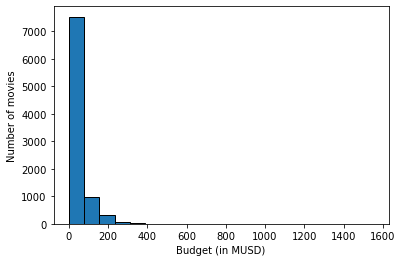

In [198]:
plt.hist(tmdb_df_27['budget']/1000000, bins=20, edgecolor='k')
plt.xlabel('Budget (in MUSD)')
plt.ylabel('Number of movies')
plt.show()

In [199]:
tmdb_df_27_a = tmdb_df_27

In [200]:
tmdb_df_27_a['budget'] = np.log(tmdb_df_27['budget'])

In [201]:
pd.options.display.float_format = '{:,.2f}'.format
stat_budget = tmdb_df_27_a['budget'].describe()
stat_budget

count   8,942.00
mean       16.74
std         1.50
min         6.93
25%        15.91
50%        16.95
75%        17.76
max        21.16
Name: budget, dtype: float64

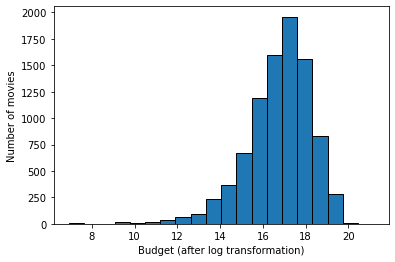

In [202]:
plt.hist(tmdb_df_27_a['budget'], bins=20, edgecolor='k')
plt.xlabel('Budget (after log transformation)')
plt.ylabel('Number of movies')
plt.show()

In [203]:
# checking what proportion of values are considered as outliers (+- 3 std from the mean)
budget_outliers_h = stat_budget[1]+3*(stat_budget[2])
budget_outliers_l = stat_budget[1]-3*(stat_budget[2])
outliers_budget = tmdb_df_27_a[(tmdb_df_27_a['budget']>budget_outliers_h) | (tmdb_df_27_a['budget']<budget_outliers_l)]
len(outliers_budget)/len(tmdb_df_27_a)

0.011183180496533215

In [204]:
print(budget_outliers_h)
print(budget_outliers_l)

21.257557602254813
12.22883096132099


In [205]:
tmdb_df_27_a.shape

(8942, 44)

In [206]:
tmdb_df_27_b = tmdb_df_27_a.drop(outliers_budget.index)

In [207]:
tmdb_df_27_b.shape

(8842, 44)

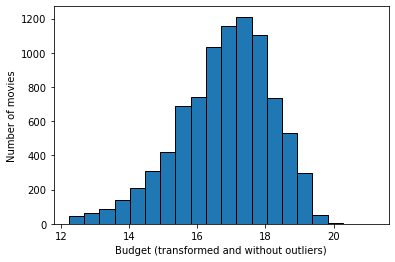

In [208]:
plt.hist(tmdb_df_27_b['budget'], bins=20, edgecolor='k')
plt.xlabel('Budget (transformed and without outliers)')
plt.ylabel('Number of movies')
plt.show()

In [209]:
tmdb_df_27_b['budget'].describe()

count   8,842.00
mean       16.81
std         1.38
min        12.23
25%        15.96
50%        16.97
75%        17.77
max        21.16
Name: budget, dtype: float64

### Runtime

In [210]:
tmdb_df_27 = tmdb_df_27_b

In [211]:
tmdb_df_27['runtime'].describe()

count   8,842.00
mean      108.00
std        21.22
min        50.00
25%        94.00
50%       104.00
75%       118.00
max       432.00
Name: runtime, dtype: float64

In [212]:
# index of dispersion
(tmdb_df_27['runtime'].describe()[2]*tmdb_df_27['runtime'].describe()[2])/tmdb_df_27['runtime'].describe()[1]

4.169671018409889

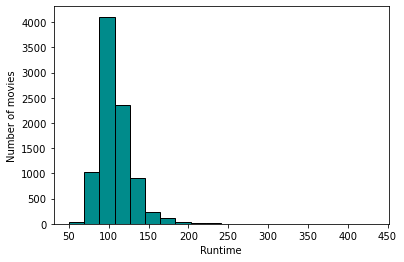

In [213]:
plt.hist(tmdb_df_27['runtime'], bins=20, edgecolor='k', color='darkcyan')
plt.xlabel('Runtime')
plt.ylabel('Number of movies')
plt.show()

In [214]:
# Applying log on this column
tmdb_df_27['runtime'] = np.log(tmdb_df_27['runtime'])

In [215]:
stat_runtime = tmdb_df_27['runtime'].describe()
stat_runtime

count   8,842.00
mean        4.67
std         0.18
min         3.91
25%         4.54
50%         4.64
75%         4.77
max         6.07
Name: runtime, dtype: float64

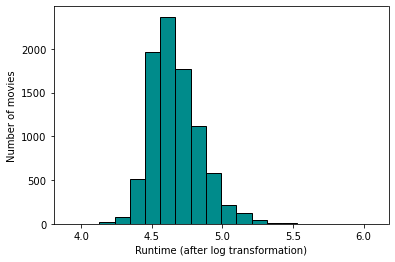

In [216]:
plt.hist(tmdb_df_27['runtime'], bins=20, edgecolor='k', color='darkcyan')
plt.xlabel('Runtime (after log transformation)')
plt.ylabel('Number of movies')
plt.show()

In [217]:
runtime_outliers_h = stat_runtime[1]+3*(stat_runtime[2])
runtime_outliers_l = stat_runtime[1]-3*(stat_runtime[2])
outliers_runtime = tmdb_df_27[(tmdb_df_27['runtime']>runtime_outliers_h) | (tmdb_df_27['runtime']<runtime_outliers_l)]
print(runtime_outliers_h)
print(runtime_outliers_l)
print(len(outliers_runtime)/len(tmdb_df_27))

5.19662183904976
4.1345363716797525
0.009273919927618186


In [218]:
len(outliers_runtime)

82

In [219]:
tmdb_df_28 = tmdb_df_27.drop(outliers_runtime.index)

In [220]:
tmdb_df_28.shape

(8760, 44)

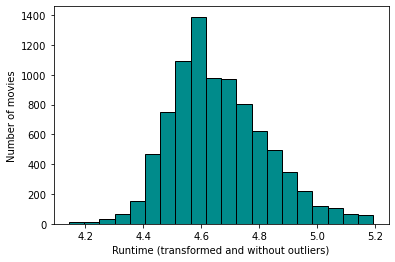

In [221]:
plt.hist(tmdb_df_28['runtime'], bins=20, edgecolor='k', color='darkcyan')
plt.xlabel('Runtime (transformed and without outliers)')
plt.ylabel('Number of movies')
plt.show()

### Various other pre-processing steps 

In [222]:
# dropping year (categorical variable but not usable for the model)
tmdb_df_29 = tmdb_df_28.drop('year', axis=1)

In [223]:
tmdb_df_29.columns

Index(['id', 'title', 'belongs_to_collection', 'overview', 'runtime', 'rating',
       'genre_Action', 'genre_Adventure', 'genre_Comedy', 'genre_Crime',
       'genre_Drama', 'genre_Family', 'genre_Fantasy', 'genre_History',
       'genre_Horror', 'genre_Mystery', 'genre_Romance',
       'genre_Science Fiction', 'genre_Thriller', 'major_companies', 'DE',
       'FR', 'GB', 'US', 'en', 'month_1', 'month_2', 'month_3', 'month_4',
       'month_5', 'month_6', 'month_7', 'month_8', 'month_9', 'month_10',
       'month_11', 'month_12', 'rating_G', 'rating_NC-17', 'rating_PG',
       'rating_PG-13', 'rating_R', 'budget'],
      dtype='object')

In [224]:
tmdb_df_29['id'] = tmdb_df_29['id'].astype(object)

In [225]:
# converting features in boolean type
for column in tmdb_df_29.columns:
    if tmdb_df_29[column].dtype == 'int64':
        tmdb_df_29[column] = tmdb_df_29[column].astype(bool)
    elif tmdb_df_29[column].dtype == 'uint8':
            tmdb_df_29[column] = tmdb_df_29[column].astype(bool)

In [226]:
columns_to_prefix = ['DE', 'FR', 'GB', 'US']
prefix = 'production_country_'
rename_dict = {column: prefix + column for column in columns_to_prefix}
tmdb_df_29 = tmdb_df_29.rename(columns=rename_dict)

In [227]:
tmdb_df_30 = tmdb_df_29.rename(columns={'major_companies':'major_production_companies'})
tmdb_df_30 = tmdb_df_30.rename(columns={'en':'language_en'})

### Saving the df to csv to test model with original variables

##### Additional pre processing steps to avoid overfitting and multicollinearity

In [228]:
tmdb_df_30_b = tmdb_df_30.drop(['title', 'overview', 'belongs_to_collection'], axis=1)
tmdb_df_30_c = tmdb_df_30_b.drop('id', axis=1)

In [229]:
tmdb_df_30_b.to_csv('path where we want to save this csv')

In [230]:
tmdb_df_30.shape

(8760, 43)

In [231]:
tmdb_df_30.columns

Index(['id', 'title', 'belongs_to_collection', 'overview', 'runtime', 'rating',
       'genre_Action', 'genre_Adventure', 'genre_Comedy', 'genre_Crime',
       'genre_Drama', 'genre_Family', 'genre_Fantasy', 'genre_History',
       'genre_Horror', 'genre_Mystery', 'genre_Romance',
       'genre_Science Fiction', 'genre_Thriller', 'major_production_companies',
       'production_country_DE', 'production_country_FR',
       'production_country_GB', 'production_country_US', 'language_en',
       'month_1', 'month_2', 'month_3', 'month_4', 'month_5', 'month_6',
       'month_7', 'month_8', 'month_9', 'month_10', 'month_11', 'month_12',
       'rating_G', 'rating_NC-17', 'rating_PG', 'rating_PG-13', 'rating_R',
       'budget'],
      dtype='object')

# Engineered variables

### Collection 

In [232]:
tmdb_df_31 = tmdb_df_30

In [233]:
tmdb_df_31[tmdb_df_31['title']=='Fast & Furious 6']

,id,title,belongs_to_collection,overview,runtime,rating,genre_Action,genre_Adventure,genre_Comedy,genre_Crime,...,month_9,month_10,month_11,month_12,rating_G,rating_NC-17,rating_PG,rating_PG-13,rating_R,budget
2973,82992,Fast & Furious 6,"{'id': 9485, 'name': 'The Fast and the Furious...",Hobbs has Dominic and Brian reassemble their c...,4.88,6.82,True,False,False,True,...,False,False,False,False,False,False,False,True,False,19.12


In [234]:
# looking at the content of belongs_to_collection variable
tmdb_df_31['belongs_to_collection'][2973]

"{'id': 9485, 'name': 'The Fast and the Furious Collection', 'poster_path': '/yvr1Ziehgps1VJyug8nnezTJRJW.jpg', 'backdrop_path': '/z5A5W3WYJc3UVEWljSGwdjDgQ0j.jpg'}"

In [235]:
# Creating a column with the collection name
tmdb_df_31['belongs_to_collection'].fillna("{'id': 'NO', 'name': 'NO', 'poster_path': 'NO', 'backdrop_path': 'NO'}", inplace=True)
tmdb_df_31['belongs_to_collection'] = tmdb_df_31['belongs_to_collection'].apply(lambda x: '[' + x + ']')
tmdb_df_31['collection_name'] = tmdb_df_31['belongs_to_collection'].apply(lambda x: ', '.join([col['name'] for col in eval(x)]))

In [236]:
# need to add release date to the dataset to consider only the movies released before the one we are considering
# tmdb_df_20 is the last df with the release_year variable
release_date = tmdb_df_20[['id', 'release_date']]
tmdb_df_32 = tmdb_df_31.merge(release_date, how='left', on='id')

In [237]:
# average rating of previous movies in the collection
# sorting by release date so calculation of average only if previous movie in the collection
tmdb_df_32.sort_values('release_date', inplace=True)

for i, row in tmdb_df_32.iterrows():
    if row['collection_name'] != "NO":
        # Filter movies with the same collection name and released before the current movie
        filtered_movies = tmdb_df_32[(row['collection_name'] == tmdb_df_32['collection_name']) & 
                                     (tmdb_df_32['release_date'] < row['release_date'])]
        
        # Calculate the average rating
        average_rating_collection = filtered_movies['rating'].mean()
        
        # Assign the average rating to the 'average_rating' column
        tmdb_df_32.at[i, 'average_rating_collection'] = average_rating_collection

In [238]:
pd.options.display.float_format = '{:,.2f}'.format 
tmdb_df_32[tmdb_df_32['collection_name']=='The Fast and the Furious Collection'][
    ['title', 'release_date', 'rating', 'average_rating_collection']]

,title,release_date,rating,average_rating_collection
4767,The Fast and the Furious,2001-06-22,6.96,NaN
2983,2 Fast 2 Furious,2003-06-05,6.48,6.96
4663,The Fast and the Furious: Tokyo Drift,2006-06-03,6.45,6.72
6159,Fast & Furious,2009-04-02,6.68,6.63
2075,Fast Five,2011-04-20,7.25,6.64
2548,Fast & Furious 6,2013-05-21,6.82,6.76
6624,Furious 7,2015-04-01,7.24,6.77
7412,The Fate of the Furious,2017-04-12,6.89,6.84
7665,F9,2021-05-19,7.17,6.85


In [239]:
# difference between the average rating of the collection and the actual rating of the movie
rating_diff = tmdb_df_32[['title', 'collection_name', 'rating', 'average_rating_collection']]
rating_diff['difference'] = rating_diff['rating'] - rating_diff['average_rating_collection']
rating_diff['difference'].describe()

C:\Users\quent\AppData\Local\Temp\ipykernel_16668\198475210.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  rating_diff['difference'] = rating_diff['rating'] - rating_diff['average_rating_collection']


count   967.00
mean     -0.47
std       0.70
min      -3.38
25%      -0.85
50%      -0.41
75%      -0.07
max       2.13
Name: difference, dtype: float64

In [240]:
# movie with the lowest difference between average rating of collection and the movie rating
rating_diff[rating_diff['difference']==rating_diff['difference'].min()]

,title,collection_name,rating,average_rating_collection,difference
382,S. Darko,Darko Collection,4.40,7.78,-3.38


In [241]:
tmdb_df_32[tmdb_df_32['collection_name']=='Darko Collection']

,id,title,belongs_to_collection,overview,runtime,rating,genre_Action,genre_Adventure,genre_Comedy,genre_Crime,...,month_12,rating_G,rating_NC-17,rating_PG,rating_PG-13,rating_R,budget,collection_name,release_date,average_rating_collection
2739,141,Donnie Darko,"[{'id': 178106, 'name': 'Darko Collection', 'p...","After narrowly escaping a bizarre accident, a ...",4.74,7.78,False,False,False,False,...,False,False,False,False,False,True,16.11,Darko Collection,2001-10-24,NaN
382,17532,S. Darko,"[{'id': 178106, 'name': 'Darko Collection', 'p...",Seven years after the events of the first film...,4.63,4.40,False,False,False,True,...,False,False,False,False,False,True,15.51,Darko Collection,2009-04-28,7.78


In [242]:
# movie with the highest difference between average rating of collection and the movie rating
rating_diff[rating_diff['difference']==rating_diff['difference'].max()]

,title,collection_name,rating,average_rating_collection,difference
8406,The Snow Queen: Mirror Lands,Snow Queen Collection,7.84,5.70,2.13


In [243]:
tmdb_df_32[tmdb_df_32['collection_name']=='Snow Queen Collection']

,id,title,belongs_to_collection,overview,runtime,rating,genre_Action,genre_Adventure,genre_Comedy,genre_Crime,...,month_12,rating_G,rating_NC-17,rating_PG,rating_PG-13,rating_R,budget,collection_name,release_date,average_rating_collection
6610,164372,The Snow Queen,"[{'id': 374930, 'name': 'Snow Queen Collection...",The ice-cold Snow Queen wishes to turn the wor...,4.33,5.70,False,False,False,False,...,False,False,False,True,False,False,16.00,Snow Queen Collection,2012-10-11,NaN
8406,564145,The Snow Queen: Mirror Lands,"[{'id': 374930, 'name': 'Snow Queen Collection...",A mighty king has lost his family because of t...,4.47,7.84,False,True,True,False,...,True,False,False,True,False,False,15.60,Snow Queen Collection,2018-12-21,5.70


In [244]:
tmdb_df_33 = tmdb_df_32.reset_index()
tmdb_df_34 = tmdb_df_33.rename(columns={'index': 'old_index'})

In [245]:
# number and % of movies with a value in the column
print(tmdb_df_34[tmdb_df_34['average_rating_collection'].notna()].shape)
print(len(tmdb_df_34[tmdb_df_34['average_rating_collection'].notna()])/ len(tmdb_df_34))

(967, 47)
0.11038812785388127


In [246]:
# top 5 collection
tmdb_coll = tmdb_df_34[tmdb_df_34['collection_name']!="NO"]
tmdb_coll['collection_name'].value_counts().head(5)

James Bond Collection         25
Halloween Collection          11
Friday the 13th Collection    11
Hellraiser Collection         10
Star Wars Collection           9
Name: collection_name, dtype: int64

In [247]:
# average number of movies per collection
tmdb_coll['collection_name'].value_counts().mean()

1.8512323943661972

In [248]:
tmdb_df_34.columns

Index(['old_index', 'id', 'title', 'belongs_to_collection', 'overview',
       'runtime', 'rating', 'genre_Action', 'genre_Adventure', 'genre_Comedy',
       'genre_Crime', 'genre_Drama', 'genre_Family', 'genre_Fantasy',
       'genre_History', 'genre_Horror', 'genre_Mystery', 'genre_Romance',
       'genre_Science Fiction', 'genre_Thriller', 'major_production_companies',
       'production_country_DE', 'production_country_FR',
       'production_country_GB', 'production_country_US', 'language_en',
       'month_1', 'month_2', 'month_3', 'month_4', 'month_5', 'month_6',
       'month_7', 'month_8', 'month_9', 'month_10', 'month_11', 'month_12',
       'rating_G', 'rating_NC-17', 'rating_PG', 'rating_PG-13', 'rating_R',
       'budget', 'collection_name', 'release_date',
       'average_rating_collection'],
      dtype='object')

In [249]:
tmdb_df_35 = tmdb_df_34.drop(['belongs_to_collection', 'collection_name'], axis=1)

In [250]:
tmdb_df_35.shape

(8760, 45)

### Number of production companies 

In [251]:
# number of production companies for the movie by using pc_list from tmdb_df_16
pc_list=tmdb_df_16[['pc_list', 'id']]
tmdb_df_36 = tmdb_df_35.merge(pc_list, how='left', on='id')

def count_production_companies(row):
    return len(row['pc_list'].split(','))
tmdb_df_36['num_pc'] = tmdb_df_36.apply(count_production_companies, axis=1)
tmdb_df_36['num_pc'] = tmdb_df_36['num_pc'].astype(float)

In [252]:
tmdb_df_36['num_pc']

0      1.00
1      1.00
2      2.00
3      1.00
4      1.00
       ... 
8755   2.00
8756   4.00
8757   1.00
8758   4.00
8759   5.00
Name: num_pc, Length: 8760, dtype: float64

In [253]:
tmdb_df_36.columns

Index(['old_index', 'id', 'title', 'overview', 'runtime', 'rating',
       'genre_Action', 'genre_Adventure', 'genre_Comedy', 'genre_Crime',
       'genre_Drama', 'genre_Family', 'genre_Fantasy', 'genre_History',
       'genre_Horror', 'genre_Mystery', 'genre_Romance',
       'genre_Science Fiction', 'genre_Thriller', 'major_production_companies',
       'production_country_DE', 'production_country_FR',
       'production_country_GB', 'production_country_US', 'language_en',
       'month_1', 'month_2', 'month_3', 'month_4', 'month_5', 'month_6',
       'month_7', 'month_8', 'month_9', 'month_10', 'month_11', 'month_12',
       'rating_G', 'rating_NC-17', 'rating_PG', 'rating_PG-13', 'rating_R',
       'budget', 'release_date', 'average_rating_collection', 'pc_list',
       'num_pc'],
      dtype='object')

In [254]:
tmdb_df_37 = tmdb_df_36.drop(['old_index', 'pc_list'], axis=1)

In [255]:
tmdb_df_37.shape

(8760, 45)

## Credits 

In [256]:
credits_df = pd.read_csv('path of the csv that contains credits API results')

In [257]:
credits_df = credits_df.drop('Unnamed: 0', axis=1)

### Cast 

In [258]:
# example of content for the movie Triangle of Sadness
credits_df[credits_df['id']==497828]

,id,cast,crew
8201,497828,"[{'adult': False, 'gender': 2, 'id': 1716493, ...","[{'adult': False, 'gender': 2, 'id': 4834, 'kn..."


In [259]:
credits_df['cast'][8201]

"[{'adult': False, 'gender': 2, 'id': 1716493, 'known_for_department': 'Acting', 'name': 'Harris Dickinson', 'original_name': 'Harris Dickinson', 'popularity': 25.063, 'profile_path': '/pqqnYWWHa3Va80EXofXrVlRqIDM.jpg', 'cast_id': 4, 'character': 'Carl', 'credit_id': '5e39d4affd7aa40017040320', 'order': 0}, {'adult': False, 'gender': 1, 'id': 1187068, 'known_for_department': 'Acting', 'name': 'Charlbi Dean', 'original_name': 'Charlbi Dean', 'popularity': 7.864, 'profile_path': '/bdWguLfrKPfRVIFvEOsVNMdeqw9.jpg', 'cast_id': 5, 'character': 'Yaya', 'credit_id': '5e39d4c1ac8e6b001ac87308', 'order': 1}, {'adult': False, 'gender': 2, 'id': 57755, 'known_for_department': 'Acting', 'name': 'Woody Harrelson', 'original_name': 'Woody Harrelson', 'popularity': 27.696, 'profile_path': '/igxYDQBbTEdAqaJxaW6ffqswmUU.jpg', 'cast_id': 128, 'character': 'Thomas, The Captain', 'credit_id': '63e18023cb802800a1a4fc27', 'order': 2}, {'adult': False, 'gender': 2, 'id': 31960, 'known_for_department': 'Actin

In [260]:
credits_df['crew'][8201]

"[{'adult': False, 'gender': 2, 'id': 4834, 'known_for_department': 'Production', 'name': 'Jim Stark', 'original_name': 'Jim Stark', 'popularity': 4.446, 'profile_path': None, 'credit_id': '627ebad563d71300522148a5', 'department': 'Production', 'job': 'Executive Producer'}, {'adult': False, 'gender': 2, 'id': 7407, 'known_for_department': 'Production', 'name': 'Bradley Thomas', 'original_name': 'Bradley Thomas', 'popularity': 1.975, 'profile_path': '/faE3s1dmajLR2qUxSs9e55I5j0M.jpg', 'credit_id': '62158dd90499f2006805854e', 'department': 'Production', 'job': 'Executive Producer'}, {'adult': False, 'gender': 2, 'id': 18824, 'known_for_department': 'Production', 'name': 'Philippe Bober', 'original_name': 'Philippe Bober', 'popularity': 1.967, 'profile_path': None, 'credit_id': '5e39d5ceac8e6b001ac873c6', 'department': 'Production', 'job': 'Producer'}, {'adult': False, 'gender': 2, 'id': 56370, 'known_for_department': 'Directing', 'name': 'Ruben Östlund', 'original_name': 'Ruben Östlund',

In [261]:
credits_df['id_list'] = credits_df['cast'].apply(lambda x: ', '.join([str(c['id']) for c in eval(x)]))
credits_df['order_list'] = credits_df['cast'].apply(lambda x: ', '.join([str(c['order']) for c in eval(x)]))

In [262]:
# Keeping only the 5 first elements for ids
credits_df['id_list'] = credits_df['id_list'].str.split(',').str[:5].apply(','.join)

In [263]:
# Splitting the id
credits_df[['id_cast1', 'id_cast2', 'id_cast3', 'id_cast4', 'id_cast5']] = credits_df['id_list'].str.split(',', expand=True)

In [264]:
# Keeping the last element of the order_list column will enable us to know the number of actors (+1 because starts at 0)
credits_df['number_cast'] = credits_df['order_list'].str.split(',').str[-1]
credits_df['number_cast'] = pd.to_numeric(credits_df['number_cast'], errors='coerce').fillna(0).astype(int) + 1

In [265]:
credits_df['number_cast'].describe()

count   8,760.00
mean       36.03
std        24.54
min         1.00
25%        19.00
50%        30.00
75%        46.00
max       331.00
Name: number_cast, dtype: float64

In [266]:
# index of dispersion
(credits_df['number_cast'].describe()[2]*credits_df['number_cast'].describe()[2])/credits_df['number_cast'].describe()[1]

16.71186096156818

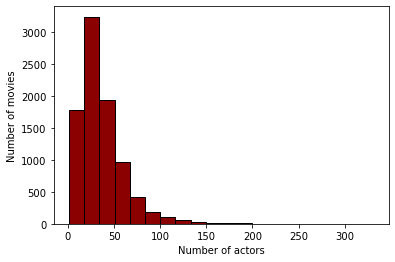

In [267]:
#1st hist
plt.hist(credits_df['number_cast'], bins=20, edgecolor='k', color='darkred')
plt.xlabel('Number of actors')
plt.ylabel('Number of movies')
plt.show()

In [268]:
# Applying square root on this column
credits_df['number_cast'] = np.cbrt(credits_df['number_cast'])

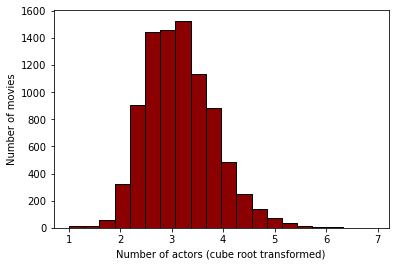

In [269]:
plt.hist(credits_df['number_cast'], bins=20, edgecolor='k', color='darkred')
plt.xlabel('Number of actors (cube root transformed)')
plt.ylabel('Number of movies')
plt.show()

In [270]:
credits_df['number_cast'].describe()

count   8,760.00
mean        3.16
std         0.67
min         1.00
25%         2.67
50%         3.11
75%         3.58
max         6.92
Name: number_cast, dtype: float64

In [271]:
stat_number_cast = credits_df['number_cast'].describe()
number_cast_outliers_h = stat_number_cast[1]+3*(stat_number_cast[2])
number_cast_outliers_l = stat_number_cast[1]-3*(stat_number_cast[2])
outliers_number_cast= credits_df[(credits_df['number_cast']>number_cast_outliers_h) | (credits_df['number_cast']<number_cast_outliers_l)]
print(number_cast_outliers_h)
print(number_cast_outliers_l)
print(len(outliers_number_cast)/len(credits_df))

5.164355958252514
1.1612050588573548
0.006506849315068493


In [272]:
credits_df_2 = credits_df.drop(outliers_number_cast.index)

In [273]:
credits_df_2.shape

(8703, 11)

### Crew 

In [274]:
credits_df_2['id_crew_list'] = credits_df_2['crew'].apply(lambda x: ', '.join([str(c['id']) for c in eval(x)]))
credits_df_2['job_list'] = credits_df_2['crew'].apply(lambda x: ', '.join([str(c['job']) for c in eval(x)]))

In [275]:
# number of crew members
credits_df_2['number_crew'] = credits_df_2['id_crew_list'].str.split(',').apply(lambda x: len(x))

In [276]:
credits_df_2['number_crew'].describe()

count   8,703.00
mean       65.79
std        74.24
min         2.00
25%        21.00
50%        40.00
75%        84.00
max       980.00
Name: number_crew, dtype: float64

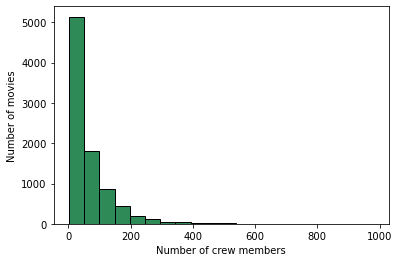

In [277]:
plt.hist(credits_df_2['number_crew'], bins=20, edgecolor='k', color='seagreen')
plt.xlabel('Number of crew members')
plt.ylabel('Number of movies')
plt.show()

In [278]:
# Applying log on this column
credits_df_2['number_crew'] = np.log(credits_df_2['number_crew'])

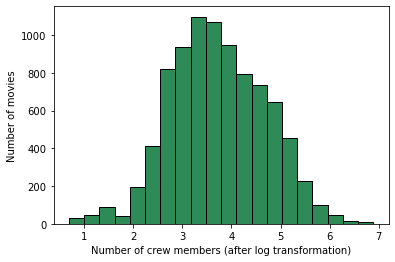

In [279]:
plt.hist(credits_df_2['number_crew'], bins=20, edgecolor='k', color='seagreen')
plt.xlabel('Number of crew members (after log transformation)')
plt.ylabel('Number of movies')
plt.show()

In [280]:
stat_crew = credits_df_2['number_crew'].describe()
stat_crew

count   8,703.00
mean        3.73
std         0.97
min         0.69
25%         3.04
50%         3.69
75%         4.43
max         6.89
Name: number_crew, dtype: float64

In [281]:
#outliers
crew_outliers_h = stat_crew[1]+3*(stat_crew[2])
crew_outliers_l = stat_crew[1]-3*(stat_crew[2])
outliers_crew = credits_df_2[(credits_df_2['number_crew']>crew_outliers_h) | (credits_df_2['number_crew']<crew_outliers_l)]
print(crew_outliers_h)
print(crew_outliers_l)
print(len(outliers_crew)/len(credits_df_2))

6.630379804205459
0.8222874380702723
0.004136504653567736


In [282]:
credits_df_3 = credits_df_2.drop(outliers_crew.index)

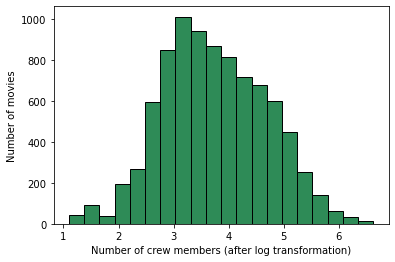

In [283]:
#3nd hist
plt.hist(credits_df_3['number_crew'], bins=20, edgecolor='k', color='seagreen')
plt.xlabel('Number of crew members (after log transformation)')
plt.ylabel('Number of movies')
plt.show()

In [284]:
credits_df_3.shape

(8667, 14)

In [285]:
# list of jobs
job_df = credits_df_3['job_list'].str.get_dummies(sep=', ')

In [286]:
job_df.shape

(8667, 877)

In [287]:
list_job = job_df.sum().sort_values(ascending=False)/ len(job_df)
list_job

Director                   1.00
Producer                   0.96
Editor                     0.95
Director of Photography    0.92
Production Design          0.79
                           ... 
Keyboard Programmer        0.00
Music Co-Supervisor        0.00
Musical Casting            0.00
On Set Computer Graphics   0.00
Helping Hand               0.00
Length: 877, dtype: float64

In [289]:
# only keeping jobs that are in at least 70% of the movies in our dataset
important_jobs = list_job[list_job >= 0.70].index.tolist()
len(important_jobs)

7

In [290]:
important_jobs

['Director',
 'Producer',
 'Editor',
 'Director of Photography',
 'Production Design',
 'Original Music Composer',
 'Costume Design']

#### Directors

In [291]:
# Keeping the ids of director
credits_df_3['id_crew_list'] = credits_df_3['id_crew_list'].str.split(',')
credits_df_3['job_list'] = credits_df_3['job_list'].str.split(',')

def filter_ids_dir(row):
    return [id for id, job in zip(row['id_crew_list'], row['job_list']) if job.strip() == 'Director']

credits_df_3['directors_id'] = credits_df_3.apply(filter_ids_dir, axis=1)

In [292]:
# checking when there is multiple directors
def check_multiple_ids(row):
    return len(row['directors_id']) > 1

credits_df_3['multiple_directors'] = credits_df_3.apply(check_multiple_ids, axis=1)

len(credits_df_3[credits_df_3['multiple_directors']==True])

481

In [293]:
# movie with the highest number of directors
def calculate_number_directors(row):
    return len(row['directors_id'])

# Apply the function to create a new column with the maximum number of directors
credits_df_3['number_directors'] = credits_df_3.apply(calculate_number_directors, axis=1)

# Get the maximum number of directors across all rows
max_directors = credits_df_3['number_directors'].max()

In [294]:
max_directors

21

In [295]:
credits_df_3[credits_df_3['number_directors']==max_directors]

,id,cast,crew,id_list,order_list,id_cast1,id_cast2,id_cast3,id_cast4,id_cast5,number_cast,id_crew_list,job_list,number_crew,directors_id,multiple_directors,number_directors
3621,2266,"[{'adult': False, 'gender': 2, 'id': 884, 'kno...","[{'adult': False, 'gender': 1, 'id': 90, 'know...","884, 524, 5293, 1579, 22165","0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, ...",884,524,5293,1579,22165,3.68,"[90, 90, 104, 1357, 1357, 1071, 1071, 1...","[Director, Writer, Director of Photography, ...",4.45,"[90, 1357, 1071, 1223, 1224, 2163, 5140,...",True,21


In [296]:
# keeping only one director id (or none)
def get_first_id(row):
    if len(row['directors_id']) > 0:
        return row['directors_id'][0]
    else:
        return None
credits_df_3['director_id'] = credits_df_3.apply(get_first_id, axis=1)

In [297]:
credits_df_3.shape

(8667, 18)

#### Original Music Composer 

In [298]:
def filter_ids_mus(row):
    return [id for id, job in zip(row['id_crew_list'], row['job_list']) if job.strip() == 'Original Music Composer']

credits_df_3['composers_id'] = credits_df_3.apply(filter_ids_mus, axis=1)

In [299]:
# checking when there is multiple composers
def check_multiple_ids(row):
    return len(row['composers_id']) > 1

credits_df_3['multiple_composers'] = credits_df_3.apply(check_multiple_ids, axis=1)

len(credits_df_3[credits_df_3['multiple_composers']==True])

804

In [300]:
# Keeping one music composer
def get_first_id(row):
    if len(row['composers_id']) > 0:
        return row['composers_id'][0]
    else:
        return None
credits_df_3['composer_id'] = credits_df_3.apply(get_first_id, axis=1)

#### Producers 

In [301]:
def filter_ids_prod(row):
    return [id for id, job in zip(row['id_crew_list'], row['job_list']) if job.strip() == 'Producer']

credits_df_3['producers_id'] = credits_df_3.apply(filter_ids_prod, axis=1)

In [302]:
# movie with the highest number of producers
def calculate_number_producers(row):
    return len(row['producers_id'])

# Apply the function to create a new column with the maximum number of producers
credits_df_3['number_producers'] = credits_df_3.apply(calculate_number_producers, axis=1)

# Get the maximum number of producers across all rows
max_producers = credits_df_3['number_producers'].max()

In [303]:
print(len(credits_df_3[credits_df_3['number_producers']>=2]))

6010


In [304]:
# producer 1
def get_first_id(row):
    if len(row['producers_id']) > 0:
        return row['producers_id'][0]
    else:
        return None
credits_df_3['producer1_id'] = credits_df_3.apply(get_first_id, axis=1)

In [305]:
# producer 2
def get_second_id(row):
    if len(row['producers_id']) > 1:
        return row['producers_id'][1]
    else:
        return None
credits_df_3['producer2_id'] = credits_df_3.apply(get_second_id, axis=1)

In [306]:
credits_df_4 = credits_df_3.rename(columns={'cast1':'cast_id1', 'cast2':'cast_id2', 'cast3':'cast_id3', 
                                            'cast4':'cast_id4', 'cast5':'cast_id5'})

In [307]:
credits_df_4.shape

(8667, 25)

In [308]:
credits_df_4.columns

Index(['id', 'cast', 'crew', 'id_list', 'order_list', 'id_cast1', 'id_cast2',
       'id_cast3', 'id_cast4', 'id_cast5', 'number_cast', 'id_crew_list',
       'job_list', 'number_crew', 'directors_id', 'multiple_directors',
       'number_directors', 'director_id', 'composers_id', 'multiple_composers',
       'composer_id', 'producers_id', 'number_producers', 'producer1_id',
       'producer2_id'],
      dtype='object')

In [309]:
# merging both dataset (credits and movie info)
tmdb_df_38 = tmdb_df_37.merge(credits_df_4, how='right', on='id')

In [310]:
tmdb_df_38.shape

(8667, 69)

In [311]:
tmdb_df_38.columns

Index(['id', 'title', 'overview', 'runtime', 'rating', 'genre_Action',
       'genre_Adventure', 'genre_Comedy', 'genre_Crime', 'genre_Drama',
       'genre_Family', 'genre_Fantasy', 'genre_History', 'genre_Horror',
       'genre_Mystery', 'genre_Romance', 'genre_Science Fiction',
       'genre_Thriller', 'major_production_companies', 'production_country_DE',
       'production_country_FR', 'production_country_GB',
       'production_country_US', 'language_en', 'month_1', 'month_2', 'month_3',
       'month_4', 'month_5', 'month_6', 'month_7', 'month_8', 'month_9',
       'month_10', 'month_11', 'month_12', 'rating_G', 'rating_NC-17',
       'rating_PG', 'rating_PG-13', 'rating_R', 'budget', 'release_date',
       'average_rating_collection', 'num_pc', 'cast', 'crew', 'id_list',
       'order_list', 'id_cast1', 'id_cast2', 'id_cast3', 'id_cast4',
       'id_cast5', 'number_cast', 'id_crew_list', 'job_list', 'number_crew',
       'directors_id', 'multiple_directors', 'number_directors',

#### Average rating cast1 to cast5

In [312]:
tmdb_df_38['release_date'] = pd.to_datetime(tmdb_df_38['release_date'])

In [313]:
num_actors = tmdb_df_38['id_list'].str.get_dummies(sep=', ')
num_composer = tmdb_df_38['composers_id'].str.get_dummies(sep=', ')
num_producer = tmdb_df_38['producers_id'].str.get_dummies(sep=', ')
num_director = tmdb_df_38['directors_id'].str.get_dummies(sep=', ')

In [314]:
print(len(num_actors.columns))
print(len(num_composer.columns))
print(len(num_producer.columns))
print(len(num_director.columns))
print(len(num_composer.columns) + len(num_actors.columns) + len(num_director.columns) + len(num_producer.columns))

16486
2950
12365
4504
36305


In [315]:
tmdb_df_38['id_cast2'][1]

' 105900'

In [316]:
# additional space for cast ids to remove
columns_to_clean = ['id_cast1', 'id_cast2', 'id_cast3', 'id_cast4', 'id_cast5']

# Removing spaces
tmdb_df_38[columns_to_clean] = tmdb_df_38[columns_to_clean].apply(lambda x: x.str.strip())

In [317]:
tmdb_df_38['id_cast2'][1]

'105900'

In [318]:
# additional cleaning steps to calculate average rating of cast 2 to 5 correctly
tmdb_df_38['id_cast2'].fillna("NO", inplace=True)
tmdb_df_38['id_cast3'].fillna("NO", inplace=True)
tmdb_df_38['id_cast4'].fillna("NO", inplace=True)
tmdb_df_38['id_cast5'].fillna("NO", inplace=True)

In [319]:
len(tmdb_df_38[tmdb_df_38['id_cast1'].isna()])

0

In [320]:
# Average rating and number of previous movies for the 1st actor
# sorting by release date so calculation only if previous movie with this actor (as one of the five major actor)

tmdb_df_38.sort_values('release_date', inplace=True)

for i, row in tmdb_df_38.iterrows():
    filtered_movies = tmdb_df_38[((row['id_cast1'] == tmdb_df_38['id_cast1']) | (row['id_cast1'] == tmdb_df_38['id_cast2']) |
                                 (row['id_cast1'] == tmdb_df_38['id_cast3']) | (row['id_cast1'] == tmdb_df_38['id_cast4']) |
                                 (row['id_cast1'] == tmdb_df_38['id_cast5'])) & 
                                 (tmdb_df_38['release_date'] < row['release_date'])]
    # Calculate the average rating
    average_rating_collection = filtered_movies['rating'].mean()
    # Assign the average rating to the 'average_rating' column
    tmdb_df_38.at[i, 'average_rating_cast1'] = average_rating_collection

In [321]:
len(tmdb_df_38[tmdb_df_38['average_rating_cast1'].isna()])

1983

##### Check if worked correctly 

In [322]:
tmdb_df_38[tmdb_df_38['title']=='Darkest Hour']

,id,title,overview,runtime,rating,genre_Action,genre_Adventure,genre_Comedy,genre_Crime,genre_Drama,...,number_directors,director_id,composers_id,multiple_composers,composer_id,producers_id,number_producers,producer1_id,producer2_id,average_rating_cast1
7668,399404,Darkest Hour,"In May 1940, the fate of World War II hangs on...",4.83,7.35,False,False,False,False,True,...,1,36588,[],False,None,"[ 2236, 2238, 113526, 948648, 1041394]",5,2236,2238,6.71


In [323]:
tmdb_df_38.loc[7668]

id                                                                 399404
title                                                        Darkest Hour
overview                In May 1940, the fate of World War II hangs on...
runtime                                                              4.83
rating                                                               7.35
                                              ...                        
producers_id                   [ 2236,  2238,  113526,  948648,  1041394]
number_producers                                                        5
producer1_id                                                         2236
producer2_id                                                         2238
average_rating_cast1                                                 6.71
Name: 7668, Length: 70, dtype: object

In [324]:
print(tmdb_df_38[tmdb_df_38['id']==399404]['id_cast1'])
print(tmdb_df_38[tmdb_df_38['id']==399404]['release_date'])

7668    64
Name: id_cast1, dtype: object
7668   2017-11-22
Name: release_date, dtype: datetime64[ns]


In [325]:
# looking at all movies where the actor with id 64 starred to check the calculation
f = tmdb_df_38[((tmdb_df_38['id_cast1'] == '64') | (tmdb_df_38['id_cast2'] == '64') | 
                (tmdb_df_38['id_cast3'] == '64') | (tmdb_df_38['id_cast4'] == '64') | 
                (tmdb_df_38['id_cast5'] == '64'))]
cutoff_date = pd.to_datetime('2017-11-22')
f[f['release_date']<cutoff_date]['rating'].mean()

6.713545454545455

#### 2nd actor 

In [326]:
# Average rating of previous movies for the 2nd actor
for i, row in tmdb_df_38.iterrows():
    if row['id_cast2'] != "NO":
        filtered_movies = tmdb_df_38[((row['id_cast2'] == tmdb_df_38['id_cast1']) | (row['id_cast2'] == tmdb_df_38['id_cast2']) |
                                 (row['id_cast2'] == tmdb_df_38['id_cast3']) | (row['id_cast2'] == tmdb_df_38['id_cast4']) |
                                 (row['id_cast2'] == tmdb_df_38['id_cast5'])) & 
                                 (tmdb_df_38['release_date'] < row['release_date'])]
        average_rating_collection = filtered_movies['rating'].mean()
        tmdb_df_38.at[i, 'average_rating_cast2'] = average_rating_collection

In [327]:
len(tmdb_df_38[tmdb_df_38['average_rating_cast2'].isna()])

2742

In [328]:
print(tmdb_df_38[tmdb_df_38['id']==399404]['id_cast2'])

7668    5470
Name: id_cast2, dtype: object


In [329]:
# also checking if worked correctly
tmdb_df_38.loc[7668]

id                                                                 399404
title                                                        Darkest Hour
overview                In May 1940, the fate of World War II hangs on...
runtime                                                              4.83
rating                                                               7.35
                                              ...                        
number_producers                                                        5
producer1_id                                                         2236
producer2_id                                                         2238
average_rating_cast1                                                 6.71
average_rating_cast2                                                 6.41
Name: 7668, Length: 71, dtype: object

In [330]:
f2 = tmdb_df_38[((tmdb_df_38['id_cast1'] == '5470') | (tmdb_df_38['id_cast2'] == '5470') | 
                (tmdb_df_38['id_cast3'] == '5470') | (tmdb_df_38['id_cast4'] == '5470') | 
                (tmdb_df_38['id_cast5'] == '5470'))]
f2[f2['release_date']<cutoff_date]['rating'].mean()

6.409941176470588

#### 3rd actor 

In [331]:
# Average rating of previous movies for the 3rd actor
for i, row in tmdb_df_38.iterrows():
    if row['id_cast3'] != "NO":
        filtered_movies = tmdb_df_38[((row['id_cast3'] == tmdb_df_38['id_cast1']) | (row['id_cast3'] == tmdb_df_38['id_cast2']) |
                                 (row['id_cast3'] == tmdb_df_38['id_cast3']) | (row['id_cast3'] == tmdb_df_38['id_cast4']) |
                                 (row['id_cast3'] == tmdb_df_38['id_cast5'])) & 
                                 (tmdb_df_38['release_date'] < row['release_date'])]
        average_rating_collection = filtered_movies['rating'].mean()
        tmdb_df_38.at[i, 'average_rating_cast3'] = average_rating_collection

In [332]:
len(tmdb_df_38[tmdb_df_38['average_rating_cast3'].isna()])

3348

In [333]:
print(tmdb_df_38[tmdb_df_38['id']==399404]['id_cast3'])

7668    77335
Name: id_cast3, dtype: object


In [334]:
tmdb_df_38.loc[7668]

id                                                                 399404
title                                                        Darkest Hour
overview                In May 1940, the fate of World War II hangs on...
runtime                                                              4.83
rating                                                               7.35
                                              ...                        
producer1_id                                                         2236
producer2_id                                                         2238
average_rating_cast1                                                 6.71
average_rating_cast2                                                 6.41
average_rating_cast3                                                 6.17
Name: 7668, Length: 72, dtype: object

In [335]:
f3 = tmdb_df_38[((tmdb_df_38['id_cast1'] == '77335') | (tmdb_df_38['id_cast2'] == '77335') | 
                (tmdb_df_38['id_cast3'] == '77335') | (tmdb_df_38['id_cast4'] == '77335') | 
                (tmdb_df_38['id_cast5'] == '77335'))]
f3[f3['release_date']<cutoff_date]['rating'].mean()

6.1659999999999995

#### 4th actor 

In [336]:
# Average rating of previous movies for the 4th actor
for i, row in tmdb_df_38.iterrows():
    if row['id_cast4'] != "NO":
        filtered_movies = tmdb_df_38[((row['id_cast4'] == tmdb_df_38['id_cast1']) | (row['id_cast4'] == tmdb_df_38['id_cast2']) |
                                 (row['id_cast4'] == tmdb_df_38['id_cast3']) | (row['id_cast4'] == tmdb_df_38['id_cast4']) |
                                 (row['id_cast4'] == tmdb_df_38['id_cast5'])) & 
                                 (tmdb_df_38['release_date'] < row['release_date'])]
        average_rating_collection = filtered_movies['rating'].mean()
        tmdb_df_38.at[i, 'average_rating_cast4'] = average_rating_collection

In [337]:
len(tmdb_df_38[tmdb_df_38['average_rating_cast4'].isna()])

3914

In [338]:
print(tmdb_df_38[tmdb_df_38['id']==399404]['id_cast4'])

7668    1016168
Name: id_cast4, dtype: object


In [339]:
tmdb_df_38.loc[7668]

id                                                                 399404
title                                                        Darkest Hour
overview                In May 1940, the fate of World War II hangs on...
runtime                                                              4.83
rating                                                               7.35
                                              ...                        
producer2_id                                                         2238
average_rating_cast1                                                 6.71
average_rating_cast2                                                 6.41
average_rating_cast3                                                 6.17
average_rating_cast4                                                 6.80
Name: 7668, Length: 73, dtype: object

In [340]:
f4 = tmdb_df_38[((tmdb_df_38['id_cast1'] == '1016168') | (tmdb_df_38['id_cast2'] == '1016168') | 
                (tmdb_df_38['id_cast3'] == '1016168') | (tmdb_df_38['id_cast4'] == '1016168') | 
                (tmdb_df_38['id_cast5'] == '1016168'))]
f4[f4['release_date']<cutoff_date]['rating'].mean()

6.800999999999999

#### 5th actor 

In [341]:
# Average rating of previous movies for the 5th actor
for i, row in tmdb_df_38.iterrows():
    if row['id_cast5'] != "NO":
        filtered_movies = tmdb_df_38[((row['id_cast5'] == tmdb_df_38['id_cast1']) | (row['id_cast5'] == tmdb_df_38['id_cast2']) |
                                 (row['id_cast5'] == tmdb_df_38['id_cast3']) | (row['id_cast5'] == tmdb_df_38['id_cast4']) |
                                 (row['id_cast5'] == tmdb_df_38['id_cast5'])) & 
                                 (tmdb_df_38['release_date'] < row['release_date'])]
        average_rating_collection = filtered_movies['rating'].mean()
        tmdb_df_38.at[i, 'average_rating_cast5'] = average_rating_collection

In [342]:
len(tmdb_df_38[tmdb_df_38['average_rating_cast5'].isna()])

4539

In [343]:
print(tmdb_df_38[tmdb_df_38['id']==399404]['id_cast5'])

7668    32556
Name: id_cast5, dtype: object


In [344]:
tmdb_df_38.loc[7668]

id                                                                 399404
title                                                        Darkest Hour
overview                In May 1940, the fate of World War II hangs on...
runtime                                                              4.83
rating                                                               7.35
                                              ...                        
average_rating_cast1                                                 6.71
average_rating_cast2                                                 6.41
average_rating_cast3                                                 6.17
average_rating_cast4                                                 6.80
average_rating_cast5                                                 5.29
Name: 7668, Length: 74, dtype: object

In [345]:
f5 = tmdb_df_38[((tmdb_df_38['id_cast1'] == '32556') | (tmdb_df_38['id_cast2'] == '32556') | 
                (tmdb_df_38['id_cast3'] == '32556') | (tmdb_df_38['id_cast4'] == '32556') | 
                (tmdb_df_38['id_cast5'] == '32556'))]
f5[f5['release_date']<cutoff_date]['rating'].mean()

5.292999999999999

In [346]:
tmdb_df_38.loc[7668][['title', 'average_rating_cast1', 'average_rating_cast2', 'average_rating_cast3', 
                      'average_rating_cast4', 'average_rating_cast5']]

title                   Darkest Hour
average_rating_cast1            6.71
average_rating_cast2            6.41
average_rating_cast3            6.17
average_rating_cast4            6.80
average_rating_cast5            5.29
Name: 7668, dtype: object

In [347]:
tmdb_df_38.shape

(8667, 74)

#### Average rating of director

In [348]:
# additional space for director, writer, composer, producers id
columns_to_clean = ['director_id', 'composer_id', 'producer1_id', 'producer2_id']

# Removing spaces
tmdb_df_38[columns_to_clean] = tmdb_df_38[columns_to_clean].apply(lambda x: x.str.strip())

In [349]:
# Average rating director
tmdb_df_39 = tmdb_df_38
tmdb_df_39.sort_values('release_date', inplace=True)

for i, row in tmdb_df_39.iterrows():
    filtered_movies = tmdb_df_39[(tmdb_df_39['director_id'] == row['director_id']) & 
                                 (tmdb_df_39['release_date'] < row['release_date'])]
        
    average_rating_collection = filtered_movies['rating'].mean()
    tmdb_df_39.at[i, 'avg_rating_director'] = average_rating_collection

In [350]:
len(tmdb_df_39[tmdb_df_39['avg_rating_director'].isna()])

3706

In [351]:
tmdb_df_39.loc[7668]['director_id']

'36588'

In [352]:
tmdb_df_39[tmdb_df_39['director_id']=='36588'][['title','rating']]

,title,rating
3815,Pride & Prejudice,8.08
3814,Atonement,7.65
355,The Soloist,6.71
2027,Hanna,6.57
6928,Pan,5.97
7668,Darkest Hour,7.35
8211,The Woman in the Window,6.03
8566,Cyrano,6.47


In [353]:
tmdb_df_39.shape

(8667, 75)

#### Average rating of composer

In [354]:
tmdb_df_39['composer_id'].fillna("NO", inplace=True)

In [355]:
# Average rating composer
for i, row in tmdb_df_39.iterrows():
    if row['composer_id'] != "NO":
        filtered_movies = tmdb_df_39[(tmdb_df_39['composer_id'] == row['composer_id']) & 
                                     (tmdb_df_39['release_date'] < row['release_date'])]
        
        average_rating_collection = filtered_movies['rating'].mean()
        tmdb_df_39.at[i, 'avg_rating_composer'] = average_rating_collection

In [356]:
len(tmdb_df_39[tmdb_df_39['avg_rating_composer'].isna()])

3942

In [357]:
tmdb_df_39['producer1_id'].fillna("NO", inplace=True)
tmdb_df_39['producer2_id'].fillna("NO", inplace=True)

#### Average rating of producers  

In [358]:
# Average rating of previous movies for the 1st producer
for i, row in tmdb_df_39.iterrows():
    if row['producer1_id'] != 'NO':
        filtered_movies = tmdb_df_39[((row['producer1_id'] == tmdb_df_39['producer1_id']) | 
                                      (row['producer1_id'] == tmdb_df_39['producer2_id'])) & 
                                 (tmdb_df_39['release_date'] < row['release_date'])]
        average_rating_collection = filtered_movies['rating'].mean()
        tmdb_df_39.at[i, 'avg_rating_producer1'] = average_rating_collection

In [359]:
len(tmdb_df_39[tmdb_df_39['avg_rating_producer1'].isna()])

3255

In [360]:
# Average rating of previous movies for the 2nd producer
for i, row in tmdb_df_39.iterrows():
    if row['producer2_id'] != 'NO':
        filtered_movies = tmdb_df_39[((row['producer2_id'] == tmdb_df_39['producer1_id']) | 
                                      (row['producer2_id'] == tmdb_df_39['producer2_id'])) & 
                                 (tmdb_df_39['release_date'] < row['release_date'])]
        average_rating_collection = filtered_movies['rating'].mean()
        tmdb_df_39.at[i, 'avg_rating_producer2'] = average_rating_collection

In [361]:
len(tmdb_df_39[tmdb_df_39['avg_rating_producer2'].isna()])

5453

In [362]:
tmdb_df_40 = tmdb_df_39.rename(columns={'average_rating_cast1': 'avg_rating_cast1', 
                                        'average_rating_cast2': 'avg_rating_cast2', 
                                        'average_rating_cast3': 'avg_rating_cast3', 
                                        'average_rating_cast4': 'avg_rating_cast4',
                                        'average_rating_cast5': 'avg_rating_cast5'})

#### Is director also a producer ? 

In [363]:
tmdb_df_40['director_is_producer'] = ((tmdb_df_40['director_id'] == tmdb_df_40['producer1_id']) | 
                                        (tmdb_df_40['director_id'] == tmdb_df_40['producer2_id']))

In [364]:
len(tmdb_df_40[tmdb_df_40['director_is_producer']==True])/ len(tmdb_df_40)

0.19268489673474098

In [365]:
tmdb_df_40['director_is_producer'] = tmdb_df_40['director_is_producer'].astype(bool)

In [366]:
tmdb_df_40.shape

(8667, 79)

In [367]:
tmdb_df_40.columns

Index(['id', 'title', 'overview', 'runtime', 'rating', 'genre_Action',
       'genre_Adventure', 'genre_Comedy', 'genre_Crime', 'genre_Drama',
       'genre_Family', 'genre_Fantasy', 'genre_History', 'genre_Horror',
       'genre_Mystery', 'genre_Romance', 'genre_Science Fiction',
       'genre_Thriller', 'major_production_companies', 'production_country_DE',
       'production_country_FR', 'production_country_GB',
       'production_country_US', 'language_en', 'month_1', 'month_2', 'month_3',
       'month_4', 'month_5', 'month_6', 'month_7', 'month_8', 'month_9',
       'month_10', 'month_11', 'month_12', 'rating_G', 'rating_NC-17',
       'rating_PG', 'rating_PG-13', 'rating_R', 'budget', 'release_date',
       'average_rating_collection', 'num_pc', 'cast', 'crew', 'id_list',
       'order_list', 'id_cast1', 'id_cast2', 'id_cast3', 'id_cast4',
       'id_cast5', 'number_cast', 'id_crew_list', 'job_list', 'number_crew',
       'directors_id', 'multiple_directors', 'number_directors',

In [368]:
tmdb_df_41 = tmdb_df_40.drop(['cast', 'crew', 'cast', 'crew', 'id_list', 'order_list', 'id_cast1', 
                              'id_cast2', 'id_cast3', 'id_cast4', 'id_cast5', 'id_crew_list', 'job_list', 'directors_id', 
                              'multiple_directors', 'number_directors', 'director_id', 'multiple_composers', 
                              'composers_id', 'composer_id', 'producers_id', 'number_producers', 'producer1_id', 
                              'producer2_id'], axis=1)

In [369]:
tmdb_df_41.shape

(8667, 57)

In [370]:
tmdb_df_41_b = tmdb_df_41.drop(['title', 'overview', 'release_date'], axis=1)

In [371]:
tmdb_df_41_b.to_csv('path where we want to save this csv')

## Adding emotions on overview

In [372]:
tmdb_df_41[tmdb_df_41['id']==38]

,id,title,overview,runtime,rating,genre_Action,genre_Adventure,genre_Comedy,genre_Crime,genre_Drama,...,avg_rating_cast1,avg_rating_cast2,avg_rating_cast3,avg_rating_cast4,avg_rating_cast5,avg_rating_director,avg_rating_composer,avg_rating_producer1,avg_rating_producer2,director_is_producer
2647,38,Eternal Sunshine of the Spotless Mind,"Joel Barish, heartbroken that his girlfriend u...",4.68,8.10,False,False,False,False,True,...,6.41,6.86,6.44,5.92,6.56,5.99,7.02,5.99,6.60,False


In [373]:
tmdb_df_41['overview'][2647]

'Joel Barish, heartbroken that his girlfriend underwent a procedure to erase him from her memory, decides to do the same. However, as he watches his memories of her fade away, he realises that he still loves her, and may be too late to correct his mistake.'

In [374]:
#!pip install nltk
#!pip install spacy

In [375]:
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
import string
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('sentiwordnet') # for sentiment link to work
nltk.download('wordnet')
nltk.download('omw') # for attributing a specific sentiment and not a sentiment score

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\quent\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\quent\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package sentiwordnet to
[nltk_data]     C:\Users\quent\AppData\Roaming\nltk_data...
[nltk_data]   Package sentiwordnet is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\quent\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw to
[nltk_data]     C:\Users\quent\AppData\Roaming\nltk_data...
[nltk_data]   Package omw is already up-to-date!


True

In [376]:
# number of words in overview
min_length = tmdb_df_41['overview'].apply(lambda x: len(str(x).split())).min()
mean_length = tmdb_df_41['overview'].apply(lambda x: len(str(x).split())).mean()
max_length = tmdb_df_41['overview'].apply(lambda x: len(str(x).split())).max()

print("Minimum overview length:", min_length)
print("Average overview length:", mean_length)
print("Maximum overview length:", max_length)

Minimum overview length: 6
Average overview length: 47.48240452290297
Maximum overview length: 175


In [377]:
# EmoLex lexicon maps words to specific emotions.
def load_emolex():
    emolex = {}
    
    for line in open('C:/Users/quent/Mon Drive/THESIS/Code/NRC-emotion-lexicon-wordlevel-alphabetized-v0.92.txt'):
        if line.startswith('#'):
            continue
        word, emotion, value = line.strip().split('\t')
        if int(value) == 1:
            if word not in emolex:
                emolex[word] = []
            emolex[word].append(emotion)
    
    return emolex

emolex = load_emolex()

In [378]:
import re
import spacy
spacy = spacy.load("en_core_web_sm")

In [379]:
# preprocessing part (tokens and stopwords)
def preprocess_text(text):
    # Tokenization
    tokens = word_tokenize(text)
    # Convert to lowercase
    tokens = [token.lower() for token in tokens]
    # Remove punctuation
    tokens = [token for token in tokens if token not in string.punctuation]
    # Join tokens back into a single string
    preprocessed_text = ' '.join(tokens)
    return preprocessed_text

In [380]:
tmdb_df_41['overview_preprocessed'] = tmdb_df_41['overview'].apply(preprocess_text)

In [381]:
def preprocess_text_spacy(preprocessed_text):
    # Process the text using spaCy
    doc = spacy(preprocessed_text)
    # Lemmatize each token in the text
    lemmatized_text = " ".join([token.lemma_ for token in doc])
    # Tokenization
    tokens = word_tokenize(lemmatized_text)
    # stopwords are all the words not included in the emolex list
    emolex_words = set(emolex.keys())
    # Keeping only words included in EmoLex list
    tokens = [token for token in tokens if token in emolex_words]
    # Join tokens back into a single string
    preprocessed_text = ' '.join(tokens)
    # keeping only a to z characters
    preprocessed_text = re.sub("[^a-zA-Z]+", " ", preprocessed_text)
    return preprocessed_text

In [382]:
tmdb_df_41['overview_preprocessed_spacy'] = tmdb_df_41['overview_preprocessed'].apply(preprocess_text_spacy)

In [383]:
# example for the movie "Eternal sunshine of the spotless mind"
print(tmdb_df_41['overview'][2647])
print(tmdb_df_41['overview_preprocessed'][2647])
print(tmdb_df_41['overview_preprocessed_spacy'][2647])

Joel Barish, heartbroken that his girlfriend underwent a procedure to erase him from her memory, decides to do the same. However, as he watches his memories of her fade away, he realises that he still loves her, and may be too late to correct his mistake.
joel barish heartbroken that his girlfriend underwent a procedure to erase him from her memory decides to do the same however as he watches his memories of her fade away he realises that he still loves her and may be too late to correct his mistake
procedure erase watch fade love late mistake


In [385]:
min_length = tmdb_df_41['overview_preprocessed_spacy'].apply(lambda x: len(str(x).split())).min()
mean_length = tmdb_df_41['overview_preprocessed_spacy'].apply(lambda x: len(str(x).split())).mean()
max_length = tmdb_df_41['overview_preprocessed_spacy'].apply(lambda x: len(str(x).split())).max()

print("Minimum overview preprocessed length:", min_length)
print("Average overview preprocessed length:", mean_length)
print("Maximum overview preprocessed length:", max_length)

Minimum overview preprocessed length: 0
Average overview preprocessed length: 9.050074997115496
Maximum overview preprocessed length: 37


In [386]:
tmdb_df_41[tmdb_df_41['overview_preprocessed_spacy']==""].head(5)

,id,title,overview,runtime,rating,genre_Action,genre_Adventure,genre_Comedy,genre_Crime,genre_Drama,...,avg_rating_cast3,avg_rating_cast4,avg_rating_cast5,avg_rating_director,avg_rating_composer,avg_rating_producer1,avg_rating_producer2,director_is_producer,overview_preprocessed,overview_preprocessed_spacy
885,24018,Glen or Glenda,A psychiatrist tells two stories: one of a tra...,4.26,4.40,False,False,False,False,True,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,a psychiatrist tells two stories one of a tran...,
3024,688,The Bridges of Madison County,Photographer Robert Kincaid wanders into the l...,4.91,7.69,False,False,False,False,True,...,NaN,NaN,6.06,6.63,6.48,6.68,NaN,True,photographer robert kincaid wanders into the l...,
5067,10478,Tin Cup,A washed up golf pro working at a driving rang...,4.91,6.04,False,False,True,False,False,...,6.35,6.81,NaN,6.63,5.38,6.60,5.80,False,a washed up golf pro working at a driving rang...,
2841,345,Eyes Wide Shut,"After Dr. Bill Harford's wife, Alice, admits t...",5.07,7.47,False,False,False,False,True,...,NaN,NaN,6.15,8.02,NaN,8.18,NaN,True,after dr. bill harford 's wife alice admits to...,
433,18079,Nine Queens,Two con artists try to swindle a stamp collect...,4.74,7.74,False,False,False,True,False,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,two con artists try to swindle a stamp collect...,


In [387]:
# dropping movies without any content after pre-processing of overview
tmdb_df_42 = tmdb_df_41[tmdb_df_41['overview_preprocessed_spacy']!=""]

In [388]:
tmdb_df_42.shape

(8649, 59)

In [389]:
# creating a function for sentiment analysis of overview
def classify_emotion(overview):
    preprocessed_overview = preprocess_text(overview)
    tokens = nltk.word_tokenize(preprocessed_overview)
    emotions = []
    
    for token in tokens:
        if token in emolex:
            emotions.extend(emolex[token])
    
    return emotions

# removing positive and negative sentiments
def remove_positive_negative(emotions_list):
    return [emotion for emotion in emotions_list if emotion not in ['positive', 'negative']]

In [390]:
tmdb_df_42['overview_sentiment'] = tmdb_df_42['overview_preprocessed_spacy'].apply(classify_emotion)
tmdb_df_42['overview_sentiment'] = tmdb_df_42['overview_sentiment'] .apply(remove_positive_negative)

C:\Users\quent\AppData\Local\Temp\ipykernel_16668\4074808830.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tmdb_df_42['overview_sentiment'] = tmdb_df_42['overview_preprocessed_spacy'].apply(classify_emotion)
C:\Users\quent\AppData\Local\Temp\ipykernel_16668\4074808830.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tmdb_df_42['overview_sentiment'] = tmdb_df_42['overview_sentiment'] .apply(remove_positive_negative)


In [391]:
# example for the movie "Eternal sunshine of the spotless mind"
tmdb_df_42['overview_sentiment'][2647]

['fear', 'fear', 'anticipation', 'fear', 'joy', 'sadness', 'sadness']

In [393]:
# only keeping the 3 most represented emotion (keeping the first of the list if there is a draw)
def get_selected_emotions(emotion_list):
    emotion_counts = pd.Series(emotion_list).value_counts()
    top_emotions = emotion_counts.index[:3]
    if len(top_emotions) < 3:
        # Add additional emotions if there are fewer than 3 unique emotions
        unique_emotions = emotion_counts.index
        for emotion in emotion_list:
            if emotion not in top_emotions and emotion in unique_emotions:
                top_emotions = list(top_emotions) + [emotion]
                if len(top_emotions) >= 3:
                    break
    return list(top_emotions)

In [394]:
tmdb_df_42['selected_emotions'] = tmdb_df_42['overview_sentiment'].apply(get_selected_emotions)

C:\Users\quent\AppData\Local\Temp\ipykernel_16668\3849948993.py:2: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  emotion_counts = pd.Series(emotion_list).value_counts()
C:\Users\quent\AppData\Local\Temp\ipykernel_16668\3849948993.py:2: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  emotion_counts = pd.Series(emotion_list).value_counts()
C:\Users\quent\AppData\Local\Temp\ipykernel_16668\3849948993.py:2: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  emotion_counts = pd.Series(emotion_list).value_counts()
C:\Users\quent\AppData\Local\Temp\ipykernel_16668\3849948993.py:2: FutureWarning: The default dtype for empty Series will be 'object' instead 

C:\Users\quent\AppData\Local\Temp\ipykernel_16668\3849948993.py:2: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  emotion_counts = pd.Series(emotion_list).value_counts()
C:\Users\quent\AppData\Local\Temp\ipykernel_16668\3849948993.py:2: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  emotion_counts = pd.Series(emotion_list).value_counts()
C:\Users\quent\AppData\Local\Temp\ipykernel_16668\3849948993.py:2: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  emotion_counts = pd.Series(emotion_list).value_counts()
C:\Users\quent\AppData\Local\Temp\ipykernel_16668\3849948993.py:2: FutureWarning: The default dtype for empty Series will be 'object' instead 

In [395]:
tmdb_df_42['selected_emotions'][2647]

['fear', 'sadness', 'anticipation']

In [397]:
tmdb_df_42['selected_emotions'] = tmdb_df_42['selected_emotions'].astype(str)

C:\Users\quent\AppData\Local\Temp\ipykernel_16668\548873266.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tmdb_df_42['selected_emotions'] = tmdb_df_42['selected_emotions'].astype(str)


In [398]:
# dummy variable for each sentiment
tmdb_df_42['selected_emotions'] = tmdb_df_42['selected_emotions'].str.strip('[]').str.replace("'",'')

C:\Users\quent\AppData\Local\Temp\ipykernel_16668\220874689.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  tmdb_df_42['selected_emotions'] = tmdb_df_42['selected_emotions'].str.strip('[]').str.replace("'",'')


In [399]:
emotion_list = tmdb_df_42['selected_emotions'].str.get_dummies(sep=', ')

In [400]:
emotion_list.head(5)

,anger,anticipation,disgust,fear,joy,sadness,surprise,trust
2769,0,1,0,0,0,0,1,1
4873,0,0,1,1,0,1,0,0
2153,1,0,1,1,0,0,0,0
3264,0,1,0,1,0,0,0,0
3182,1,0,0,1,0,1,0,0


In [401]:
# creating a dataframe with the emotion variables
tmdb_df_43 = pd.concat([tmdb_df_42, emotion_list], axis = 1)

In [402]:
print(tmdb_df_42.shape)
print(tmdb_df_43.shape)

(8649, 61)
(8649, 69)


In [403]:
columns_to_prefix = ['anger', 'anticipation', 'disgust', 'fear', 'joy', 'sadness', 'surprise', 'trust']
prefix = 'emotion_'
rename_dict = {column: prefix + column for column in columns_to_prefix}
tmdb_df_44 = tmdb_df_43.rename(columns=rename_dict)

In [404]:
# checking if rows with no emotion
emotion_columns = tmdb_df_44.filter(like='emotion_')
tmdb_df_44['num_emotion'] = emotion_columns.sum(axis=1)
tmdb_df_44[tmdb_df_44['num_emotion']==0]

,id,title,overview,runtime,rating,genre_Action,genre_Adventure,genre_Comedy,genre_Crime,genre_Drama,...,selected_emotions,emotion_anger,emotion_anticipation,emotion_disgust,emotion_fear,emotion_joy,emotion_sadness,emotion_surprise,emotion_trust,num_emotion
3148,909,Meet Me in St. Louis,The life of a St. Louis family in the year bef...,4.73,7.02,False,False,True,False,True,...,,0,0,0,0,0,0,0,0,0
3032,702,A Streetcar Named Desire,A fading southern belle tries to build a new l...,4.83,7.70,False,False,False,False,True,...,,0,0,0,0,0,0,0,0,0
4354,9051,10,A Hollywood songwriter goes through a mid-life...,4.80,5.60,False,False,True,False,False,...,,0,0,0,0,0,0,0,0,0
3122,861,Total Recall,Construction worker Douglas Quaid's obsession ...,4.73,7.30,True,True,False,False,False,...,,0,0,0,0,0,0,0,0,0
4908,10163,The Lawnmower Man,A simple man is turned into a genius through t...,4.68,5.54,False,False,False,False,False,...,,0,0,0,0,0,0,0,0,0
2703,137,Groundhog Day,"A narcissistic TV weatherman, along with his a...",4.62,7.61,False,False,True,False,True,...,,0,0,0,0,0,0,0,0,0
1930,46924,Being Human,One man must learn the meaning of courage acro...,4.80,5.00,False,False,True,False,True,...,,0,0,0,0,0,0,0,0,0
5143,10634,Friday,Craig and Smokey are two guys in Los Angeles h...,4.51,7.14,False,False,True,False,False,...,,0,0,0,0,0,0,0,0,0
108,15170,Buddy,An eccentric socialite raises a gorilla as her...,4.43,4.80,False,True,True,False,False,...,,0,0,0,0,0,0,0,0,0
4953,10228,Pokemon: The First Movie,"Determined to prove its superiority, a bio-eng...",4.44,6.90,True,True,False,False,False,...,,0,0,0,0,0,0,0,0,0


In [405]:
# dropping movies without any emotion variables
tmdb_df_45 = tmdb_df_44[tmdb_df_44['num_emotion']!=0]
tmdb_df_45.shape

(8605, 70)

In [406]:
# distribution of emotion in our dataset
pd.options.display.float_format = '{:.0%}'.format
emotion_columns2 = tmdb_df_45.filter(like='emotion_')
emotion_columns2.sum().sort_values(ascending=False)/ len(emotion_columns2)

emotion_fear           58%
emotion_trust          52%
emotion_anticipation   52%
emotion_anger          40%
emotion_joy            37%
emotion_sadness        25%
emotion_surprise       17%
emotion_disgust        14%
dtype: float64

In [407]:
tmdb_df_45.columns

Index(['id', 'title', 'overview', 'runtime', 'rating', 'genre_Action',
       'genre_Adventure', 'genre_Comedy', 'genre_Crime', 'genre_Drama',
       'genre_Family', 'genre_Fantasy', 'genre_History', 'genre_Horror',
       'genre_Mystery', 'genre_Romance', 'genre_Science Fiction',
       'genre_Thriller', 'major_production_companies', 'production_country_DE',
       'production_country_FR', 'production_country_GB',
       'production_country_US', 'language_en', 'month_1', 'month_2', 'month_3',
       'month_4', 'month_5', 'month_6', 'month_7', 'month_8', 'month_9',
       'month_10', 'month_11', 'month_12', 'rating_G', 'rating_NC-17',
       'rating_PG', 'rating_PG-13', 'rating_R', 'budget', 'release_date',
       'average_rating_collection', 'num_pc', 'number_cast', 'number_crew',
       'avg_rating_cast1', 'avg_rating_cast2', 'avg_rating_cast3',
       'avg_rating_cast4', 'avg_rating_cast5', 'avg_rating_director',
       'avg_rating_composer', 'avg_rating_producer1', 'avg_rating_prod

In [408]:
tmdb_df_46 = tmdb_df_45.drop(['overview', 'overview_preprocessed', 'overview_preprocessed_spacy', 'overview_sentiment',
                             'selected_emotions', 'num_emotion']
                             , axis=1)

In [409]:
tmdb_df_46_b = tmdb_df_46.drop(['title', 'release_date'], axis=1)

In [410]:
tmdb_df_46_b.to_csv('path where we want to save this csv')

# Adding NYT reviews

In [411]:
# looking if we have movies with the same title and release the same year by creating an unique id
tmdb_df_46['year'] = tmdb_df_46['release_date'].dt.year
tmdb_df_46['year'] = tmdb_df_46['year'].astype(str)
tmdb_df_46['id_merge'] = tmdb_df_46['title'] + tmdb_df_46['year']
print(tmdb_df_46['id_merge'].nunique())

8605


In [412]:
# read csv of NYT reviews
nyt_reviews = pd.read_csv('path of the csv that contains NYT movies API results')
nyt_reviews = nyt_reviews.drop(['Unnamed: 0', 'results.headline'], axis=1)
nyt_reviews = nyt_reviews.rename(columns={'results.display_title':'title', 'results.summary_short':'nyt_summary',
                                  'results.critics_pick':'nyt_critics_pick', 'results.publication_date':'date'})

In [413]:
nyt_reviews.shape

(30258, 4)

In [414]:
# creating the merging key on the NYT dataset
nyt_reviews['date'] = pd.to_datetime(nyt_reviews['date'])
nyt_reviews['year'] = nyt_reviews['date'].dt.year
nyt_reviews['year'] = nyt_reviews['year'].astype(str)
nyt_reviews['id_merge'] = nyt_reviews['title'] + nyt_reviews['year']

In [415]:
nyt_reviews = nyt_reviews.drop_duplicates(subset=['id_merge'], keep=False)

In [416]:
# adding nyt review to our dataset
tmdb_df_47 = tmdb_df_46.merge(nyt_reviews, how='inner', on='id_merge')

In [417]:
tmdb_df_47.shape

(4870, 71)

In [418]:
# nyt_critics_pick as boolean
tmdb_df_47['nyt_critics_pick'] = tmdb_df_47['nyt_critics_pick'].astype(bool)

In [419]:
# % of movies in NYT selection
len(tmdb_df_47[tmdb_df_47['nyt_critics_pick']==True])/len(tmdb_df_47)

0.1924024640657084

In [420]:
tmdb_df_47['nyt_summary'] = tmdb_df_47['nyt_summary'].astype(str)

In [422]:
def remove_quot_marks(text):
    return re.sub(r'quot(.*?)quot', r'\1', text)
tmdb_df_47['nyt_summary'] = tmdb_df_47['nyt_summary'].apply(remove_quot_marks)

In [423]:
# we also want to remove proper nouns (name of actors, director, ...)
def remove_proper_nouns(text):
    doc = spacy(text)
    text_without_proper_nouns = ' '.join([token.text for token in doc if token.ent_type_ != 'PERSON'])
    return text_without_proper_nouns

# Apply the function to the 'review' column
tmdb_df_47['nyt_summary_preprocessed_1'] = tmdb_df_47['nyt_summary'].apply(remove_proper_nouns)

In [424]:
print(tmdb_df_47.iloc[3937]['nyt_summary'])
print(tmdb_df_47.iloc[3937]['nyt_summary_preprocessed_1'])

In this film, written and directed by Cary Joji Fukunaga, the line between innocence and evil is thinner than the blade of a machete.
In this film , written and directed by , the line between innocence and evil is thinner than the blade of a machete .


In [425]:
# creating a function for preprocessing text
def preprocess_text_nyt(text):
    # Tokenization
    tokens = word_tokenize(text)
    # Convert to lowercase
    tokens = [token.lower() for token in tokens]
    # Remove punctuation
    tokens = [token for token in tokens if token not in string.punctuation]
    preprocessed_text = ' '.join(tokens)
    doc = spacy(preprocessed_text)
    # Lemmatize each token in the text
    lemmatized_text = " ".join([token.lemma_ for token in doc])
    # Tokenization 2
    tokens = word_tokenize(lemmatized_text)
    # Remove stopwords (with base english stop words and new stopwords)
    initial_stop_words = set(stopwords.words('english'))
    new_stopwords = ['quot', "'s"] 
    stop_words = initial_stop_words.union(new_stopwords)
    negation_words = ['not', "n't", 'no', 'never', 'none'] # negation will be use to reverse polarity of certain words
    stop_words.difference_update(negation_words)
    tokens = [token for token in tokens if token not in stop_words]
    # Join tokens back into a single string
    preprocessed_text = ' '.join(tokens)
    # keeping only a to z characters
    preprocessed_text = re.sub("[^a-zA-Z]+", " ", preprocessed_text)
    return preprocessed_text

In [426]:
tmdb_df_47['nyt_summary_preprocessed'] = tmdb_df_47['nyt_summary_preprocessed_1'].apply(preprocess_text_nyt)

In [427]:
print(tmdb_df_47.iloc[3937]['nyt_summary_preprocessed_1'])
print(tmdb_df_47.iloc[3937]['nyt_summary_preprocessed'])

In this film , written and directed by , the line between innocence and evil is thinner than the blade of a machete .
film write direct line innocence evil thin blade machete


In [429]:
from nltk.sentiment import SentimentIntensityAnalyzer
nltk.download('vader_lexicon')

def get_sentiment_score(text):
    sia = SentimentIntensityAnalyzer()
    words = nltk.word_tokenize(text)
    negation_flag = False
    sentiment_score = 0

    for word in words:
        if word.lower() in ['not', "n't", 'no', 'never', 'none']:
            negation_flag = not negation_flag  # Flip the negation flag
        else:
            word_sentiment = sia.polarity_scores(word)['compound']
            if negation_flag:
                word_sentiment = -word_sentiment  # Reverse the polarity for words after negation
            sentiment_score += word_sentiment
    return sentiment_score

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\quent\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [430]:
tmdb_df_47['nyt_sentiment_score'] = tmdb_df_47['nyt_summary_preprocessed'].apply(get_sentiment_score)

In [431]:
print(tmdb_df_47.iloc[3937]['nyt_summary'])
print(tmdb_df_47.iloc[3937]['nyt_sentiment_score'])

In this film, written and directed by Cary Joji Fukunaga, the line between innocence and evil is thinner than the blade of a machete.
-0.2779


In [432]:
print(tmdb_df_47.iloc[1098]['nyt_summary'])
print(tmdb_df_47.iloc[1098]['nyt_summary_preprocessed'])
print(tmdb_df_47.iloc[1098]['nyt_sentiment_score'])

Odd, gloomy, circuitous pastiche and a mess. Ignites dark fire too late.
odd gloomy circuitous pastiche mess ignite dark fire late
-1.1725


In [433]:
print(tmdb_df_47['nyt_sentiment_score'].min())
print(tmdb_df_47['nyt_sentiment_score'].mean())
print(tmdb_df_47['nyt_sentiment_score'].max())

-6.4112
0.1141574743326486
6.3245


In [434]:
# movies outside -1 to 1 range
len(tmdb_df_47[(tmdb_df_47['nyt_sentiment_score']>1) | (tmdb_df_47['nyt_sentiment_score']<-1)])

819

In [435]:
tmdb_df_48 = tmdb_df_47[(tmdb_df_47['nyt_sentiment_score']<1) & (tmdb_df_47['nyt_sentiment_score']>-1)]
tmdb_df_48.shape

(4051, 74)

In [436]:
print(tmdb_df_48['nyt_sentiment_score'].min())
print(tmdb_df_48['nyt_sentiment_score'].mean())
print(tmdb_df_48['nyt_sentiment_score'].max())

-0.9993999999999998
0.040655048136262646
0.9988999999999999


In [437]:
tmdb_df_48.columns

Index(['id', 'title_x', 'runtime', 'rating', 'genre_Action', 'genre_Adventure',
       'genre_Comedy', 'genre_Crime', 'genre_Drama', 'genre_Family',
       'genre_Fantasy', 'genre_History', 'genre_Horror', 'genre_Mystery',
       'genre_Romance', 'genre_Science Fiction', 'genre_Thriller',
       'major_production_companies', 'production_country_DE',
       'production_country_FR', 'production_country_GB',
       'production_country_US', 'language_en', 'month_1', 'month_2', 'month_3',
       'month_4', 'month_5', 'month_6', 'month_7', 'month_8', 'month_9',
       'month_10', 'month_11', 'month_12', 'rating_G', 'rating_NC-17',
       'rating_PG', 'rating_PG-13', 'rating_R', 'budget', 'release_date',
       'average_rating_collection', 'num_pc', 'number_cast', 'number_crew',
       'avg_rating_cast1', 'avg_rating_cast2', 'avg_rating_cast3',
       'avg_rating_cast4', 'avg_rating_cast5', 'avg_rating_director',
       'avg_rating_composer', 'avg_rating_producer1', 'avg_rating_producer2',
  

In [438]:
tmdb_df_49 = tmdb_df_48.rename(columns={'title_x': 'title'})

In [439]:
tmdb_df_50 = tmdb_df_49.drop(['year_x', 'id_merge', 'title_y', 'date', 'nyt_summary', 'year_y', 
                              'nyt_summary_preprocessed_1', 'nyt_summary_preprocessed', 'release_date'], axis=1)

In [440]:
tmdb_df_51 = tmdb_df_50.drop('title', axis=1)
tmdb_df_51_b = tmdb_df_51.drop('id', axis=1)

In [441]:
# using profiling to analyse our dataset
prof = ProfileReport(tmdb_df_51_b)
prof

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [442]:
tmdb_df_52 = tmdb_df_51.drop(['language_en', 'average_rating_collection', 'rating_NC-17'], axis=1)

In [443]:
tmdb_df_52.shape

(4051, 61)

In [444]:
tmdb_df_52.columns

Index(['id', 'runtime', 'rating', 'genre_Action', 'genre_Adventure',
       'genre_Comedy', 'genre_Crime', 'genre_Drama', 'genre_Family',
       'genre_Fantasy', 'genre_History', 'genre_Horror', 'genre_Mystery',
       'genre_Romance', 'genre_Science Fiction', 'genre_Thriller',
       'major_production_companies', 'production_country_DE',
       'production_country_FR', 'production_country_GB',
       'production_country_US', 'month_1', 'month_2', 'month_3', 'month_4',
       'month_5', 'month_6', 'month_7', 'month_8', 'month_9', 'month_10',
       'month_11', 'month_12', 'rating_G', 'rating_PG', 'rating_PG-13',
       'rating_R', 'budget', 'num_pc', 'number_cast', 'number_crew',
       'avg_rating_cast1', 'avg_rating_cast2', 'avg_rating_cast3',
       'avg_rating_cast4', 'avg_rating_cast5', 'avg_rating_director',
       'avg_rating_composer', 'avg_rating_producer1', 'avg_rating_producer2',
       'director_is_producer', 'emotion_anger', 'emotion_anticipation',
       'emotion_disgust'

In [445]:
tmdb_df_52.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4051 entries, 0 to 4868
Data columns (total 61 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   id                          4051 non-null   object 
 1   runtime                     4051 non-null   float64
 2   rating                      4051 non-null   float64
 3   genre_Action                4051 non-null   bool   
 4   genre_Adventure             4051 non-null   bool   
 5   genre_Comedy                4051 non-null   bool   
 6   genre_Crime                 4051 non-null   bool   
 7   genre_Drama                 4051 non-null   bool   
 8   genre_Family                4051 non-null   bool   
 9   genre_Fantasy               4051 non-null   bool   
 10  genre_History               4051 non-null   bool   
 11  genre_Horror                4051 non-null   bool   
 12  genre_Mystery               4051 non-null   bool   
 13  genre_Romance               4051 

In [446]:
pd.options.display.float_format = '{:.2f}'.format
tmdb_df_52.describe().T

,count,mean,std,min,25%,50%,75%,max
runtime,4051.00,4.68,0.16,4.14,4.56,4.66,4.78,5.19
rating,4051.00,6.49,0.79,2.70,5.98,6.51,7.04,8.71
budget,4051.00,17.22,1.20,12.24,16.58,17.35,18.02,21.16
num_pc,4051.00,3.30,2.18,1.00,2.00,3.00,4.00,26.00
number_cast,4051.00,3.30,0.63,1.26,2.80,3.27,3.71,5.16
number_crew,4051.00,3.96,0.91,1.10,3.26,3.93,4.63,6.63
avg_rating_cast1,3414.00,6.56,0.48,2.29,6.27,6.55,6.83,8.36
avg_rating_cast2,3094.00,6.53,0.51,4.20,6.23,6.52,6.81,8.39
avg_rating_cast3,2806.00,6.50,0.54,3.08,6.20,6.50,6.81,8.34
avg_rating_cast4,2561.00,6.46,0.59,2.29,6.16,6.49,6.79,8.54


In [447]:
tmdb_df_52.to_csv('path where we want to save this csv')

### Issue of low rating 

In [448]:
# % of movies with rating <4 using tmdb_df_2_a (movies with status = released) with rating != 0
tmdb_df_2_a2 = tmdb_df_2_a[tmdb_df_2_a['rating']!=0]
tmdb_df_4_b = tmdb_df_3[tmdb_df_3['vote_count']>=10]
print("% of low rating for base dataset:", round(len(tmdb_df_2_a2[tmdb_df_2_a2['rating']<4])/len(tmdb_df_2_a)*100,2))
print("% of low rating for dataset with vote counts >50:", round(len(tmdb_df_4[tmdb_df_4['rating']<4])/len(tmdb_df_4)*100,2))
print("% of low rating for dataset with vote counts >10:", round(len(tmdb_df_4_b[tmdb_df_4_b['rating']<4])/len(tmdb_df_4_b)*100,2))

% of low rating for base dataset: 4.31
% of low rating for dataset with vote counts >50: 0.72
% of low rating for dataset with vote counts >10: 2.89


In [449]:
# proportion of movies with 0 votes
print(round(len(tmdb_df_2_a[tmdb_df_2_a['vote_count']==0])))
print(len(tmdb_df_2_a))
print(round(len(tmdb_df_2_a[tmdb_df_2_a['vote_count']==0])/len(tmdb_df_2_a)*100,2))

469726
785071
59.83


#### End of this second notebook. You can use the differents csv created in it on the third notebook to build the different models